In [130]:
import sys
import os
sys.path.append("../src/")
import combat
import numpy as np
import scipy.stats as stats
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
import sklearn
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sb
import pickle as pkl
from sklearn.linear_model import LogisticRegression, Lasso, Ridge, ElasticNet
import random as rd
import matplotlib
matplotlib.rcParams['figure.dpi'] = 500
from sklearn.preprocessing import quantile_transform,binarize
from sklearn.model_selection import LeaveOneOut,KFold
from sklearn.metrics import r2_score
from statsmodels.stats.multitest import multipletests
from sklearn.cross_decomposition import PLSRegression as PLS
import warnings
warnings.simplefilter("ignore")
from multiprocessing import Process,Queue,Pool
import time 
import helper
from multiprocessing import set_start_method
#set_start_method("spawn")
from DecoID.DecoID import flatten
from sklearn.cross_decomposition import PLSRegression
from sklearn.svm import SVC
import importlib
import helper#import the module here, so that it can be reloaded.
importlib.reload(helper)


<module 'helper' from '../src\\helper.py'>

In [2]:
results = pkl.load(open("modeling_results_qTOF_ICU.pkl","rb"))
#print(results)
results = results[results["Score"] < results["Training Score"]]
#results = results[results["Score"] > results["Training Score"] * 2/3]
bestParams = results[results["Score"] == results["Score"].max()]
ind = bestParams.index.values[0]
print(bestParams)
print(bestParams.at[ind,"Params"])
baseline = bestParams.at[ind,"Baseline"]
params = bestParams.at[ind,"Params"]
model = bestParams.at[ind,"Model"]
model_names = ["Logistic Regression","ElasticNet","PLSDA","SVM","Random Forest"]
model_train_funcs = [helper.trainLogisticRegression,helper.trainElasticNet,helper.trainPLSDA,helper.trainSVM,helper.trainRF]
model_predict_funcs = [helper.predictLogisticRegression,helper.predictElasticNet,helper.predictPLSDA,helper.predictSVM,helper.predictRF]
train_mapping = {name:func for name,func in zip(model_names,model_train_funcs)}
predict_mapping = {name:func for name,func in zip(model_names,model_predict_funcs)}

trainFunc,predictFunc = train_mapping[model],predict_mapping[model]


        Model                                             Params Baseline  \
1  ElasticNet  {'feat_selection': ('corr', 0.4444444444444444...     none   
6  ElasticNet  {'feat_selection': ('corr', 0.4444444444444444...      all   

      Score  Training Score  
1  0.838154        0.914141  
6  0.838154        0.914141  
{'feat_selection': ('corr', 0.4444444444444444), 'alpha': 10, 'l1_ratio': 0.0}


In [118]:
#load in metadata and peak areas and associate

#read in peak data
datafilename = "../data/07_30_2020_batch_1_6_qTOF_polar_non_polar_peak_areas.csv"
data = pd.read_csv(datafilename)

#get area columns
areaCols = data.columns.values[5:]

#get molecule names
mol_names = data["Compound Name"].values

#extract area data and transpose
areaData = data[areaCols].transpose()

#get batch information
batchInfo = [int(x.split("_")[0][1]) for x in list(areaData.index.values)]

areaData = areaData.to_numpy()
areaData = areaData.astype(np.float)

#get index of blanks
blankSamp = [x for x in range(len(areaCols)) if "Blank" in areaCols[x] and not "equil" in areaCols[x]]
print(len(blankSamp)," blanks")

#get index of qc
qcSamp = [x for x in range(len(areaCols)) if "NIST" in areaCols[x] and not "equil" in areaCols[x] ]
print(len(qcSamp)," qc samples")

#get index of wu350 samples
samp = [x for x in range(len(areaCols)) if "WU350" in areaCols[x] and not "equil" in areaCols[x]]
print(len(samp), "research samples")

#load in metadata
metadatafn = "../data/07_30_2020_batch_1_6_qTOF_polar_non_polar_experiment_parameters.csv"
metadata = pd.read_csv(metadatafn)

#extact sample names for d0_yes samples
metadata_rel = metadata[metadata["day-COVID"] == "d0_Yes"]
print(len(metadata_rel)," d0 Covid+ Samples")

metadata_val = metadata[metadata["day-COVID"] == "d0_No"]
print(len(metadata_val), "d0 Covid- Samples")

val_samples = []
for index,row in metadata_val.iterrows():
    val_samples.append(row["Sample General Name"])
    
val_cols = []
for val_s in val_samples:
    for col in range(len(areaCols)):
        if areaCols[col] == val_s:
            val_cols.append(col)
            break

            
#create sample name, ventilator status linkage
vent_dict = {}
metadata_dict = {}
for index,row in metadata_rel.iterrows():
    val = str(row["ICU"])
    sampName = row["Sample General Name"]
    if "es" in val:
        val = 1
    elif "o" in val:
        val = 0
    vent_dict[sampName] = val
    metadata_dict[sampName] = row

print(np.sum(list(vent_dict.values()))," ICU+ samples")
print(len(vent_dict) - np.sum(list(vent_dict.values())),"ICU- samples")

#link vent status to sample in peak data
vent_status = []
metadata_for_samples = []
for s in np.array(areaCols)[samp]:
    tmp = s
    if tmp in vent_dict:
        vent_status.append(vent_dict[tmp])
        metadata_for_samples.append(metadata_dict[tmp])
    else:
        vent_status.append(-1)
        metadata_for_samples.append(-1)

print("found vent info for",len([x for x in vent_status if x != -1]),"covid_ d0 samples")
samplesOfInterest = [x for x in range(len(vent_status)) if vent_status[x] != -1]

val_int = areaData[val_cols]
val_batch = np.array(batchInfo)[val_cols]
val_vent = np.array([0 for _ in val_batch])

#create sample matrix
samp_batch = np.array(batchInfo)[samp][samplesOfInterest]
samp_int = areaData[samp][samplesOfInterest]
samp_vent = np.array(vent_status)[samplesOfInterest]
samp_metadata = [metadata_for_samples[x] for x in samplesOfInterest]

#create blank matrix
blank_batch = np.array(batchInfo)[blankSamp]
blank_int = areaData[blankSamp]

#create qc matrix
qc_batch = np.array(batchInfo)[qcSamp]
qc_int = areaData[qcSamp]

0  blanks
0  qc samples
442 research samples
168  d0 Covid+ Samples
35 d0 Covid- Samples
83  ICU+ samples
85 ICU- samples
found vent info for 168 covid_ d0 samples


143521
0


No handles with labels found to put in legend.


Text(0, 0.5, 'PC2')

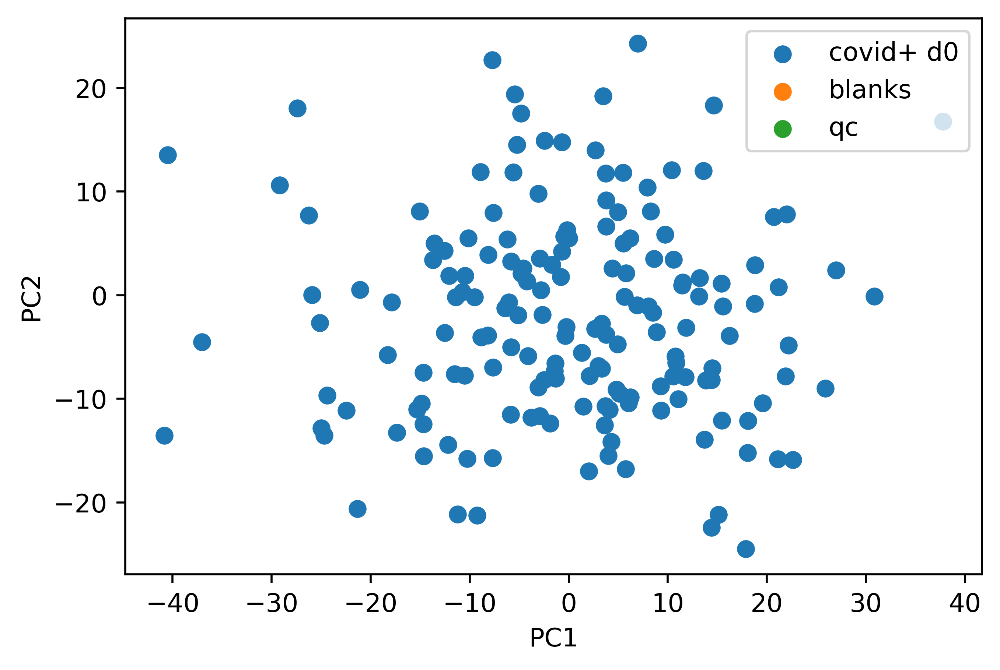

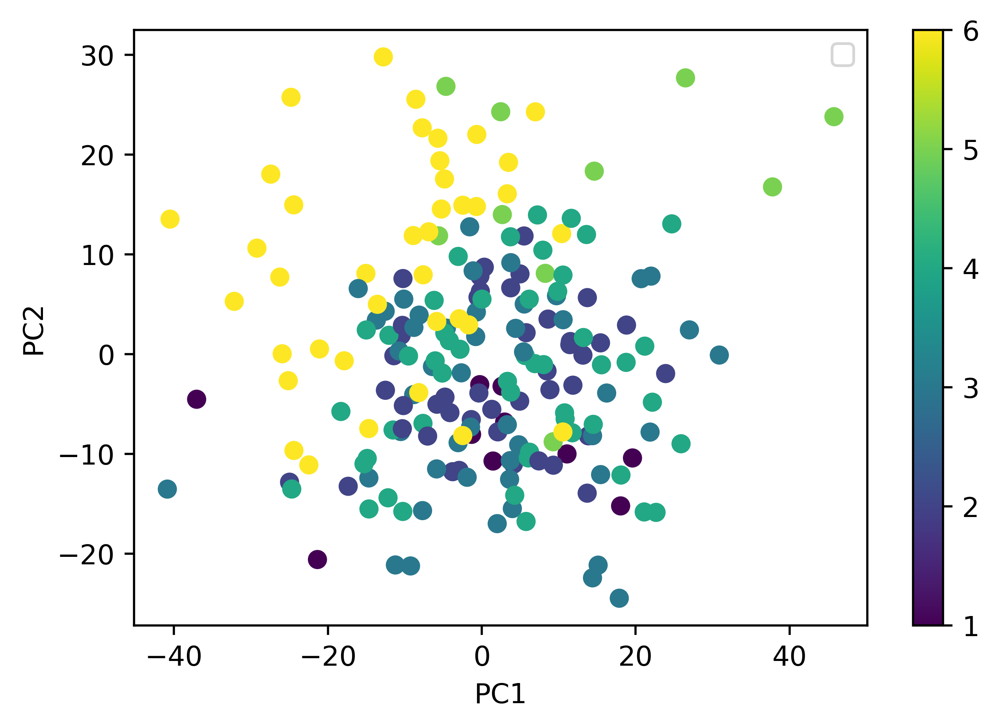

In [119]:
#visualize complete dataset

#first impute dataset
d_whole = np.concatenate((samp_int,blank_int,qc_int,val_int))
d_whole_imput = helper.imputeRowMin(d_whole)

#log2 normalize
d_whole_imput = np.log2(d_whole_imput) 

#do pca 
pca = PCA(n_components=2)
pca.fit(d_whole_imput)
loads = pca.transform(d_whole_imput)

samp_load = loads[:len(samp_int)]
blank_load = loads[len(samp_int):len(samp_int)+len(blank_int)]
qc_load = loads[len(samp_int)+len(blank_int):len(samp_int)+len(blank_int)+len(qc_int)]

#make pca plot divided by sample type
plt.scatter(samp_load[:,0],samp_load[:,1],label="covid+ d0")
plt.scatter(blank_load[:,0],blank_load[:,1],label="blanks")
plt.scatter(qc_load[:,0],qc_load[:,1],label="qc")
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")

#make pca plot by batch
plt.figure()
batch_con = np.concatenate((samp_batch,blank_batch,qc_batch,val_batch))
plt.scatter(loads[:,0],loads[:,1],c=batch_con)
plt.colorbar()
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")


found 6 batches
found 0 numerical covariates...
found 0 categorical variables:	
Standardizing Data across genes.
Fitting L/S model and finding priors
Finding parametric adjustments
No handles with labels found to put in legend.


Adjusting data


Text(0, 0.5, 'PC2')

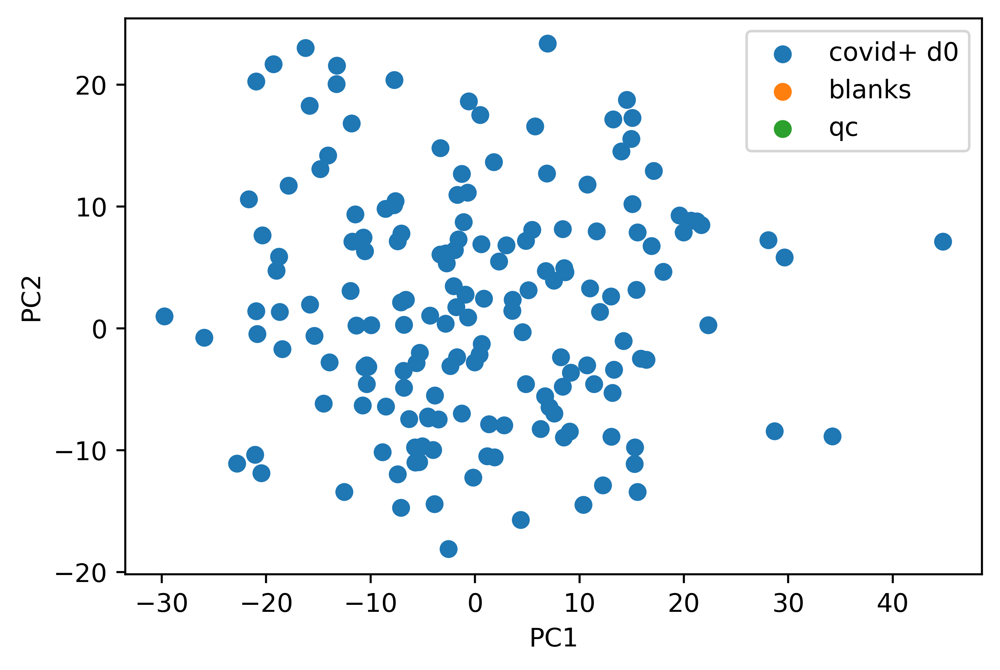

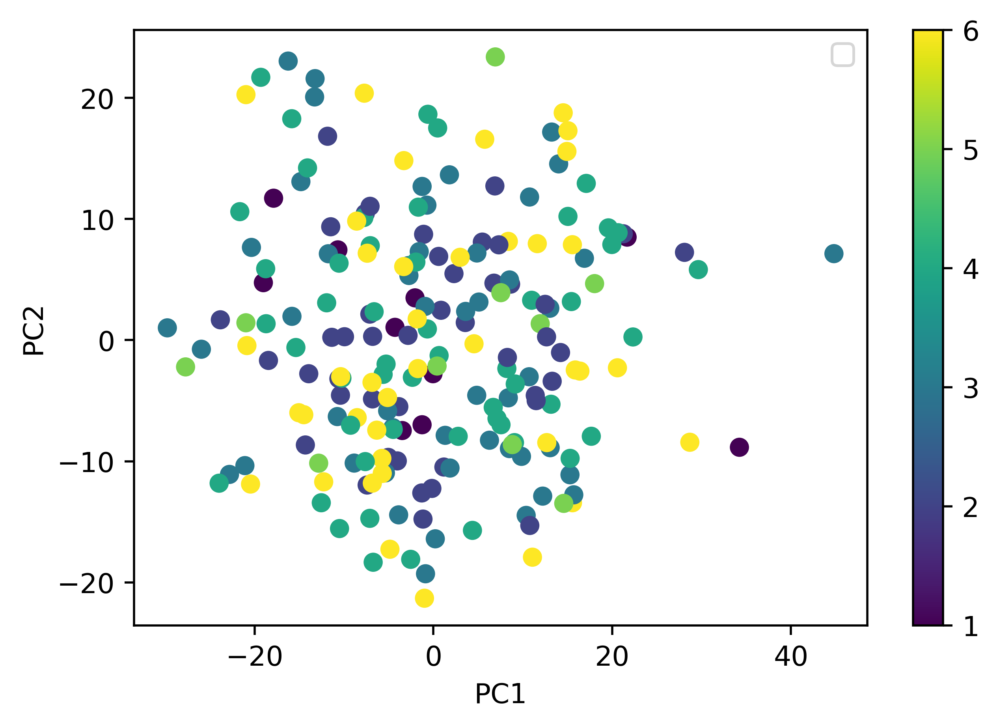

In [5]:
#now quantile normalize

d_whole_norm = combat.combat(pd.DataFrame(d_whole_imput.transpose()),np.concatenate((samp_batch,blank_batch,qc_batch,val_batch))).transpose().to_numpy()


#baseline

if baseline == "qc":
    # #baseline to qcSamps
    baseInt = [np.median(x) for x in d_whole_norm[len(samp_int) + len(blank_int):].transpose()]
    d_whole_norm = np.array([[v - med for v, med in zip(row, baseInt)] for row in d_whole_norm])

if baseline == "all":
    baseInt = [np.median(x) for x in d_whole_norm.transpose()]
    d_whole_norm = np.array([[v - med for v, med in zip(row, baseInt)] for row in d_whole_norm])




#do pca 
pca = PCA(n_components=2)
pca.fit(d_whole_norm)
loads = pca.transform(d_whole_norm)

samp_load = loads[:len(samp_int)]
blank_load = loads[len(samp_int):len(samp_int)+len(blank_int)]
qc_load = loads[len(samp_int)+len(blank_int):len(samp_int)+len(blank_int)+len(qc_int)]

#make pca plot divided by sample type
plt.scatter(samp_load[:,0],samp_load[:,1],label="covid+ d0")
plt.scatter(blank_load[:,0],blank_load[:,1],label="blanks")
plt.scatter(qc_load[:,0],qc_load[:,1],label="qc")
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")

#make pca plot by batch
plt.figure()
batch_con = np.concatenate((samp_batch,blank_batch,qc_batch,val_batch))
plt.scatter(loads[:,0],loads[:,1],c=batch_con)
plt.colorbar()
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")



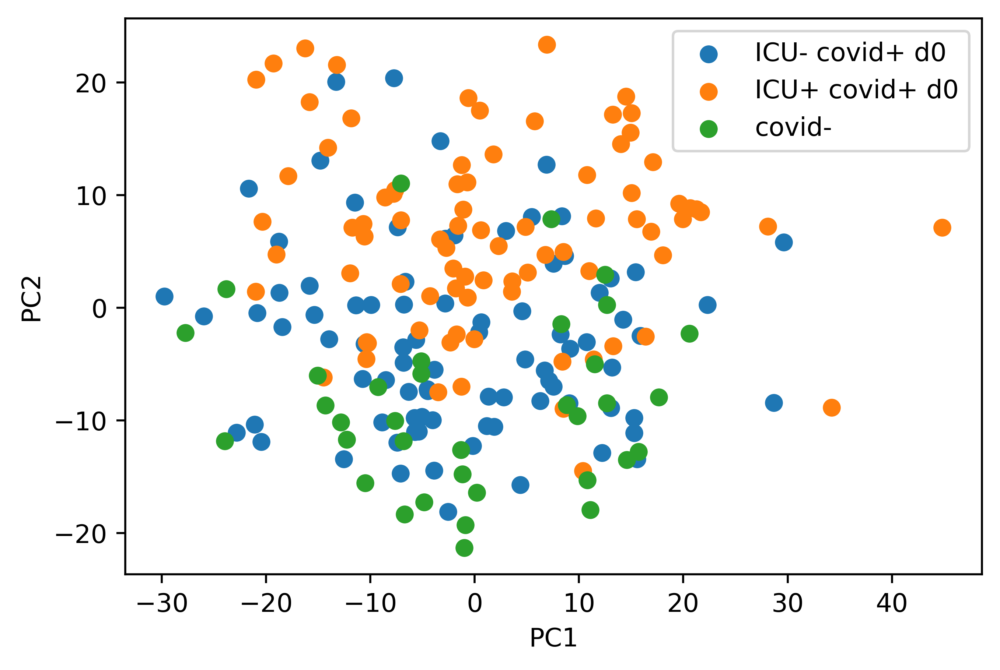

<Figure size 3000x2000 with 0 Axes>

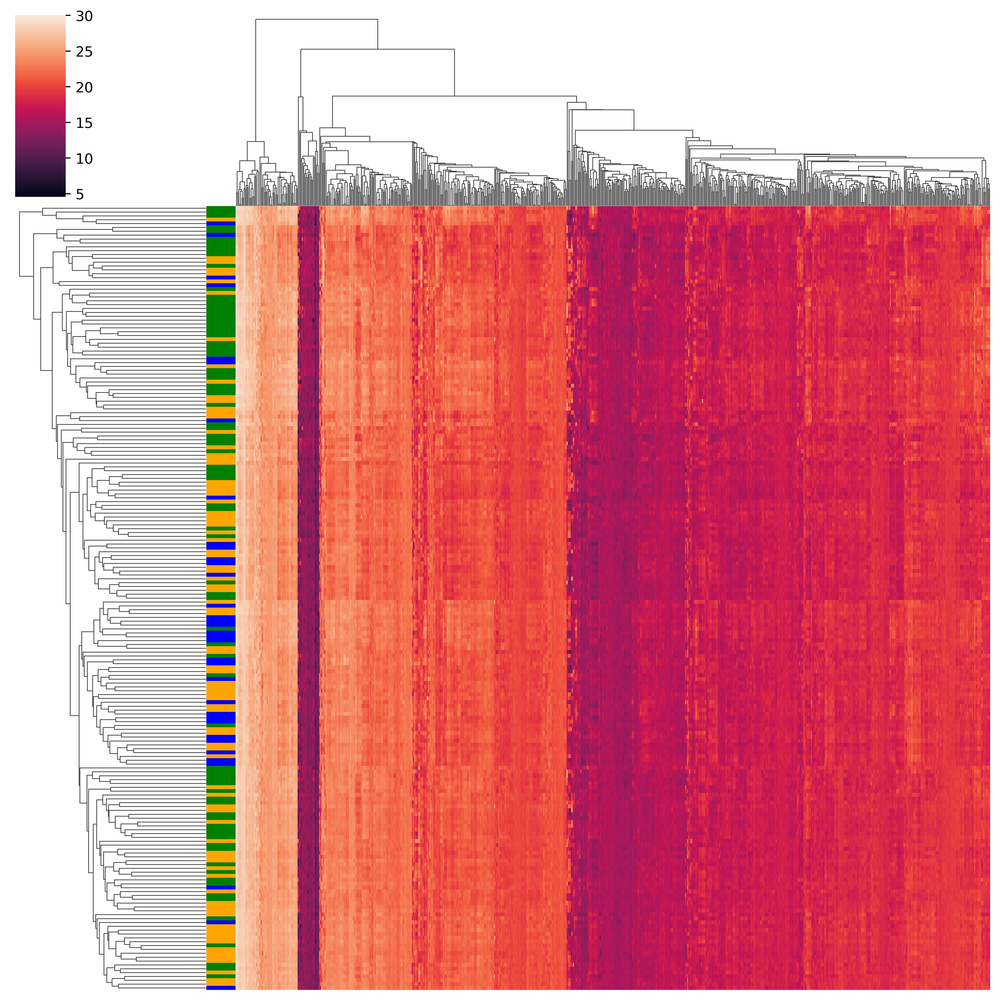

In [156]:
#now plot research samples by vent status
#do pca 
pca = PCA(n_components=2)
pca.fit(d_whole_norm)
loads = pca.transform(d_whole_norm)

#get vent pos/neg loadings
negSamples = [x for x in range(len(samp_vent)) if samp_vent[x] == 0]
posSamples = [x for x in range(len(samp_vent)) if samp_vent[x] == 1]
samp_load_vent_neg = loads[:len(samp_int)][negSamples]
samp_load_vent_pos = loads[:len(samp_int)][posSamples]

#get blanks and qc
blank_load = loads[len(samp_int):len(samp_int)+len(blank_int)]
qc_load = loads[len(samp_int)+len(blank_int):len(samp_int)+len(blank_int)+len(qc_int)]
val_load = loads[len(samp_int)+len(blank_int)+len(qc_int):]

#make pca plot divided by sample type
plt.scatter(samp_load_vent_neg[:,0],samp_load_vent_neg[:,1],label="ICU- covid+ d0")
plt.scatter(samp_load_vent_pos[:,0],samp_load_vent_pos[:,1],label="ICU+ covid+ d0")
#plt.scatter(blank_load[:,0],blank_load[:,1],label="blanks")
#plt.scatter(qc_load[:,0],qc_load[:,1],label="qc")
plt.scatter(val_load[:,0],val_load[:,1],label="covid-")
plt.legend()
plt.xlabel("PC1")
plt.ylabel("PC2")

plt.figure()

colors = ["blue" for _ in d_whole_norm]
for x in negSamples:
    colors[x] = "orange"
for x in posSamples:
    colors[x] = "green"
sb.clustermap(d_whole_norm,xticklabels=False,yticklabels=False,row_colors=colors)

In [22]:
#create train and test sets for prediction model

#train batches on 1-4
#test on 5-6

trainBatches = [1,2,3,4]
testBatches = [5,6]


#get blanks for train/test
blank_train_index = [x for x in range(len(blank_batch)) if blank_batch[x] in trainBatches]
blank_test_index = [x for x in range(len(blank_batch)) if blank_batch[x] in testBatches]

blank_train_int = blank_int[blank_train_index]
blank_test_int = blank_int[blank_test_index]

blank_train_batch = blank_batch[blank_train_index]
blank_test_batch = blank_batch[blank_test_index]

#get samples for train/test
samp_train_index = [x for x in range(len(samp_batch)) if samp_batch[x] in trainBatches]
samp_test_index = [x for x in range(len(samp_batch)) if samp_batch[x] in testBatches]

samp_train_int = samp_int[samp_train_index]
samp_test_int = samp_int[samp_test_index]

samp_train_vent = samp_vent[samp_train_index]
samp_test_vent = samp_vent[samp_test_index]

samp_train_batch = samp_batch[samp_train_index]
samp_test_batch = samp_batch[samp_test_index]

samp_train_metadata = [samp_metadata[x] for x in samp_train_index]
samp_test_metadata = [samp_metadata[x] for x in samp_test_index]

#get qc for train/test

qc_train_index = [x for x in range(len(qc_batch)) if qc_batch[x] in trainBatches]
qc_test_index = [x for x in range(len(qc_batch)) if qc_batch[x] in testBatches]

qc_train_int = qc_int[qc_train_index]
qc_test_int = qc_int[qc_test_index] 

qc_train_batch = qc_batch[qc_train_index]
qc_test_batch = qc_batch[qc_test_index] 

#need to add vent and qcs

print("training examples: ",len(samp_train_int),"testing examples: ",len(samp_test_int))
print("training ICU+ examples:, ",len([x for x in samp_train_vent if x == 1]),
      "training ICU- examples:, ",len([x for x in samp_train_vent if x == 0]))
print("testing ICU+ examples:, ",len([x for x in samp_test_vent if x == 1]),
      "testing ICU- examples:, ",len([x for x in samp_test_vent if x == 0]))

training examples:  132 testing examples:  36
training ICU+ examples:,  66 training ICU- examples:,  66
testing ICU+ examples:,  17 testing ICU- examples:,  19


In [23]:
X_train,y_train,X_test,y_test,X_train_blank = helper.normalize_data(samp_train_int,blank_train_int,qc_train_int,np.concatenate((samp_test_int,val_int)), blank_test_int, qc_test_int,samp_train_batch,
                           blank_train_batch, qc_train_batch, np.concatenate((samp_test_batch,val_batch)), blank_test_batch, qc_test_batch,samp_train_vent,np.concatenate((samp_test_vent,val_vent)),baseline)
X_test,X_val = X_test[:len(samp_test_batch)],X_test[len(samp_test_batch):]
y_test,y_val = y_test[:len(samp_test_batch)],y_test[len(samp_test_batch):]
X_train_metadata = samp_train_metadata
X_test_metadata = samp_test_metadata



found 6 batches
found 0 numerical covariates...
found 0 categorical variables:	
Standardizing Data across genes.
Fitting L/S model and finding priors
Finding parametric adjustments


Adjusting data


training score:  0.9097796143250689
testing score:  0.7987616099071209


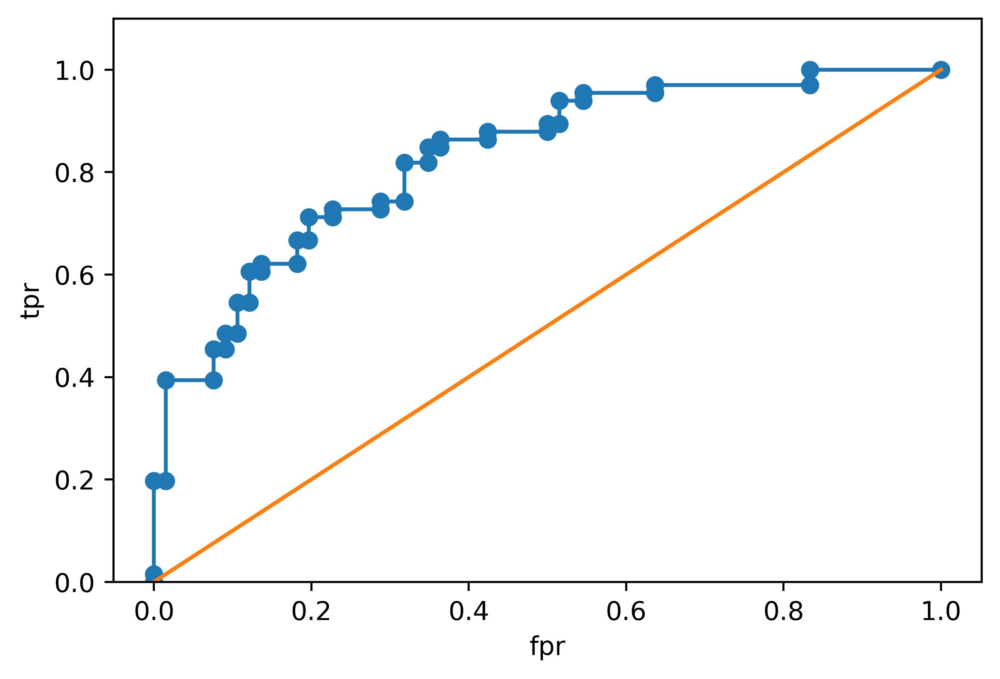

In [9]:
#fit model
feat_params = params["feat_selection"]

y_pred_cv,y_cv = helper.crossVal(X_train,y_train,X_train_blank,mol_names,trainFunc,predictFunc,params,k=20,numCores=20)

selected_feats = helper.featureSelection(X_train,y_train,X_train_blank,mol_names,feat_params,True,True)
X_train_sig = X_train[:,selected_feats]
obj = trainFunc(X_train, y_train, X_train_blank, mol_names, params)

#predict
y_pred_train = predictFunc(obj,X_train)

#assess training error
err_train = helper.score(y_pred_train,y_train)
print("training score: ",err_train)
#print(sklearn.metrics.confusion_matrix(y_train,y_pred))

plt.figure()

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_cv,y_pred_cv)
plt.plot(fpr,tpr)
plt.scatter(fpr,tpr)
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.ylim((0,1.1))
plt.plot([0,1],[0,1])
# for p,r,t in zip(precision,recall,thresolds):
#     print(p,r,t)

#assess testing error
y_test_pred = predictFunc(obj,X_test)

err_test = helper.score(y_test_pred,y_test)
print("testing score: ",err_test)
#print(sklearn.metrics.confusion_matrix(y_test,y_test_pred))

y_neg_pred = [y_test_pred[i] for i in range(len(y_test_pred)) if y_test[i] < .5]
y_pos_pred = [y_test_pred[i] for i in range(len(y_test_pred)) if y_test[i] > .5]

y_val_pred = predictFunc(obj,X_val)

    





37


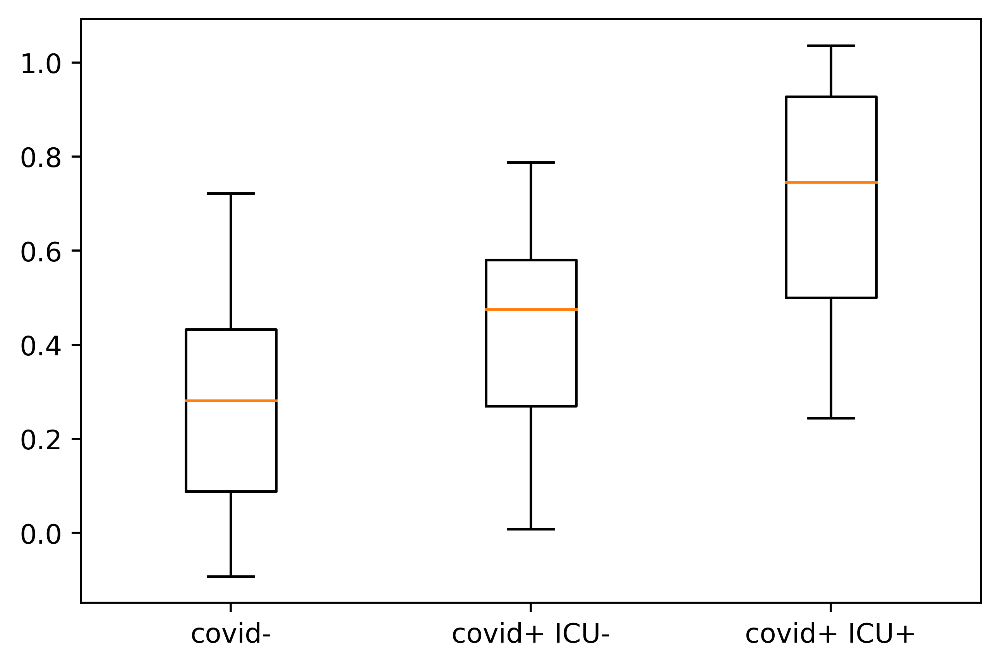

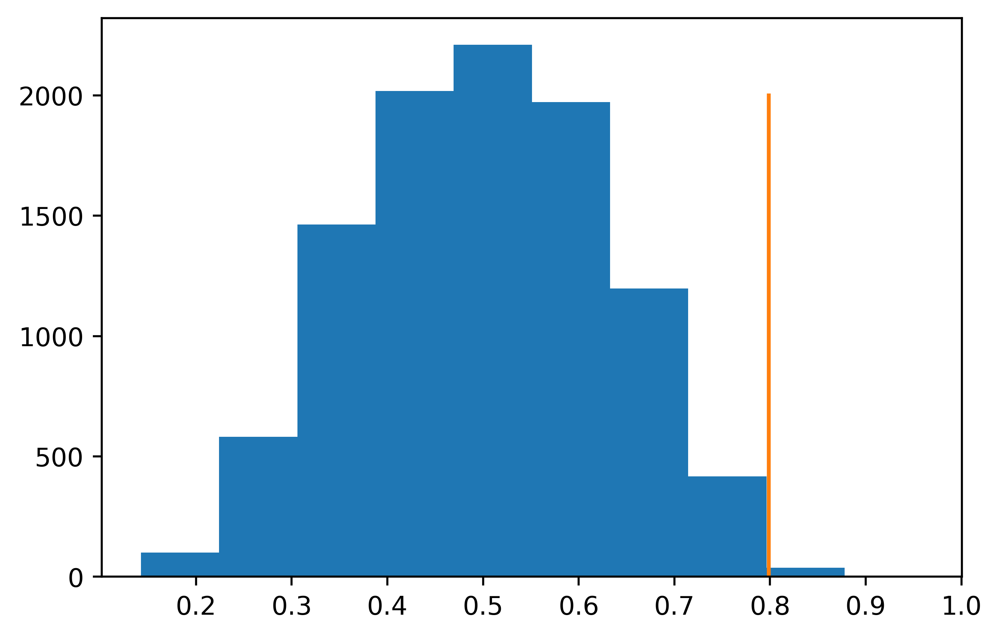

In [10]:
thresh = 0.56
plt.figure()
plt.boxplot([y_val_pred,y_neg_pred,y_pos_pred],labels=["covid-","covid+ ICU-","covid+ ICU+"])
#plt.plot(range(1,4),[thresh for _ in range(1,4)])

#y_val_pred_bin = binarize(y_val_pred,thresh)
#y_test_pred_bin = binarize(y_test_pred,thresh)

# print(sklearn.metrics.confusion_matrix(y_val,y_val_pred_bin))
# print(sklearn.metrics.confusion_matrix(y_test,y_test_pred_bin))



#permutation test
numPerm = 10000
res = []
fprs_tprs = []
for _ in range(numPerm):
    order = list(range(len(y_train)))
    rd.shuffle(order)
    y_shuff = np.array([y_train[x] for x in order])
    obj = trainFunc(X_train, y_shuff, X_train_blank, mol_names, params)
    y_pred = predictFunc(obj,X_test)
    err_shuff = helper.score(y_pred,y_test)
    res.append(err_shuff)
    fpr,tpr,_ = sklearn.metrics.roc_curve(y_test,y_pred)
    fprs_tprs.append([fpr,tpr])
    
print(len([x for x in res if x > err_test]))
    
#plot histogram
plt.figure()
plt.hist(res)
plt.plot([err_test,err_test],[0,.2*numPerm])

Sample General Name                                                     B1_WU350-013_d0_1681501b_2_2
batch                                                                                              1
group                                                                                          WU350
WU-350                                                                                     WU350-013
WU day of presentation                                                                            d0
WU day of presentation number                                                                      0
WU350-Symptom onset                                                                               11
WU350-correct day of presentation                                                                  0
WU COVID19                                                                                       Yes
day-COVID                                                                                  

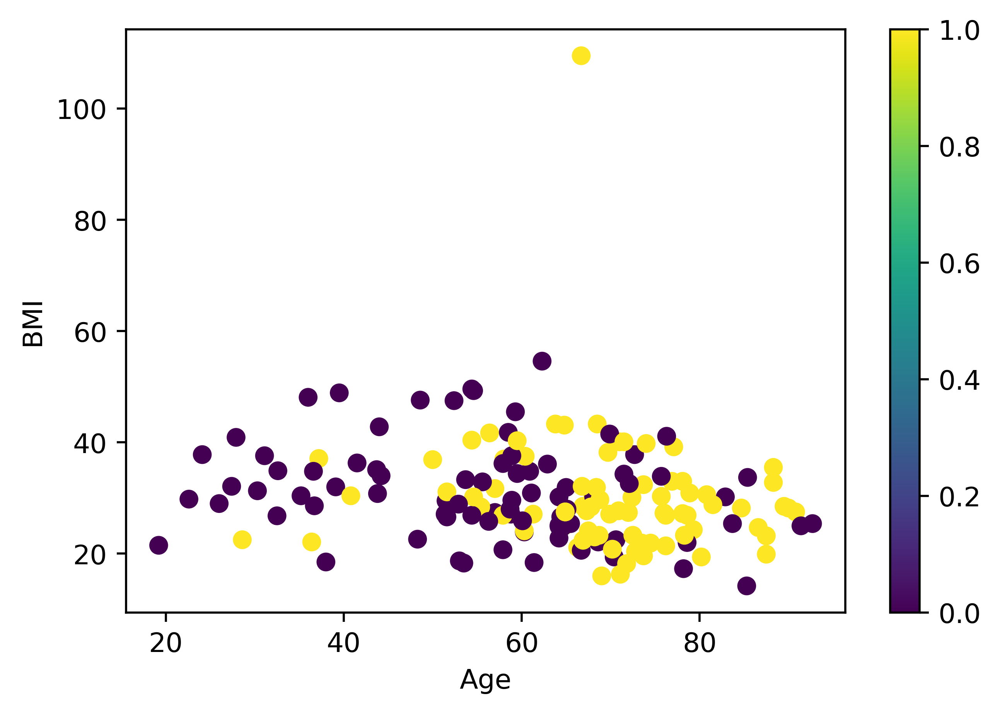

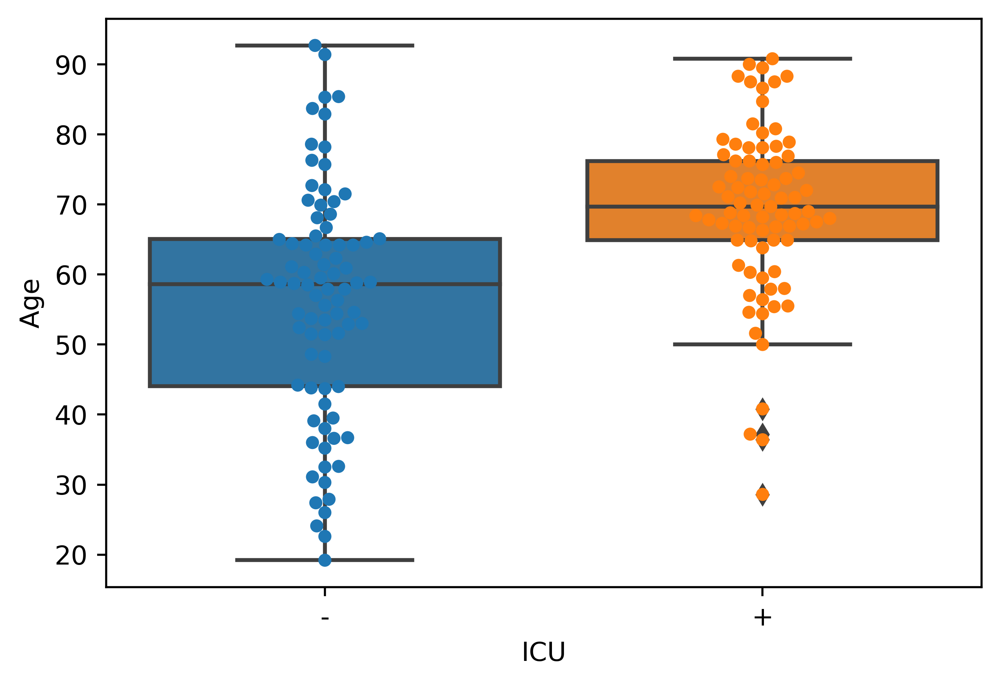

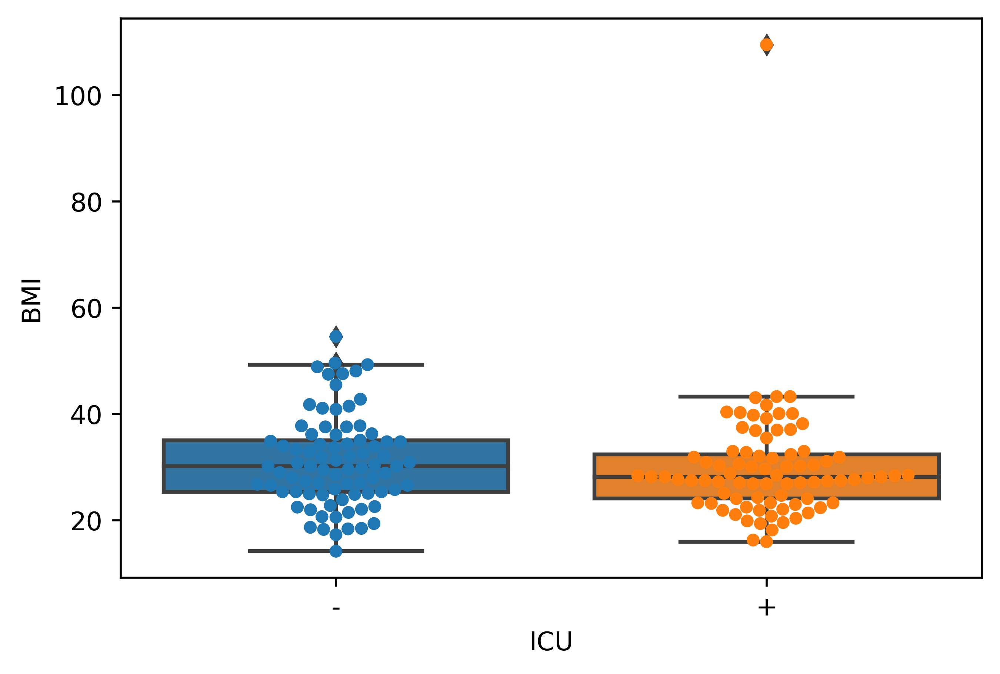

In [137]:
good_train_ind = []
print(X_train_metadata[0])
for x,i in zip(X_train_metadata,range(len(X_train_metadata))):
    try: 
        float(x["Age at Symptom onset (years)"])
        float(x["BMI"])
        good_train_ind.append(i)
    except:
        pass
    
        
good_test_ind = []
for x,i in zip(X_test_metadata,range(len(X_test_metadata))):
    try: 
        float(x["Age at Symptom onset (years)"])
        float(x["BMI"])
        good_test_ind.append(i)
    except:
        pass
        


X_train_age = [float(x["Age at Symptom onset (years)"]) for x,i in zip(X_train_metadata,range(len(X_train_metadata))) if i in good_train_ind]
X_test_age = [float(x["Age at Symptom onset (years)"]) for x,i in zip(X_test_metadata,range(len(X_test_metadata))) if i in good_test_ind]
X_train_bmi = [float(x["BMI"]) for x,i in zip(X_train_metadata,range(len(X_train_metadata))) if i in good_train_ind]
X_test_bmi = [float(x["BMI"]) for x,i in zip(X_test_metadata,range(len(X_test_metadata))) if i in good_test_ind]
X_train_baseline = np.array([X_train_age,X_train_bmi]).transpose()
X_test_baseline = np.array([X_test_age,X_test_bmi]).transpose()

y_train_baseline = y_train[good_train_ind]
y_test_baseline = y_test[good_test_ind]

y_baseline = np.concatenate((y_train_baseline,y_test_baseline))

X_baseline = np.concatenate((X_train_baseline,X_test_baseline))
plt.scatter(X_baseline[:,0],X_baseline[:,1],c=y_baseline)
plt.xlabel("Age")
plt.ylabel("BMI")

negSamples_X_baseline = np.array([x for x,yy in zip(X_baseline,y_baseline) if yy < .5])
posSamples_X_baseline = np.array([x for x,yy in zip(X_baseline,y_baseline) if yy > .5])

plt.colorbar()

plt.figure()

plot_dict = {}
ind = 0
for samp in negSamples_X_baseline:
    plot_dict[ind] = {"ICU":"-","Age":samp[0],"BMI":samp[1]}
    ind += 1
    
for samp in posSamples_X_baseline:
    plot_dict[ind] = {"ICU":"+","Age":samp[0],"BMI":samp[1]}
    ind += 1

plot_df = pd.DataFrame.from_dict(plot_dict,orient="index")

sb.boxplot(data=plot_df,x="ICU",y="Age")
sb.swarmplot(data=plot_df,x="ICU",y="Age")

plt.figure()

sb.boxplot(data=plot_df,x="ICU",y="BMI")
sb.swarmplot(data=plot_df,x="ICU",y="BMI")

print(stats.ttest_ind(negSamples_X_baseline[:,0],posSamples_X_baseline[:,0],equal_var=False))
print(stats.ttest_ind(negSamples_X_baseline[:,1],posSamples_X_baseline[:,1],equal_var=False))

log_reg = sklearn.linear_model.LinearRegression(fit_intercept=True)

log_reg.fit(X_train_baseline,y_train_baseline)

pred_baseline = log_reg.predict(X_test_baseline)

print(helper.score(pred_baseline,y_test_baseline))

[0.0, 0.21052631578947367, 0.47368421052631576, 0.42105263157894735, 0.05263157894736842, 0.5789473684210527, 0.631578947368421, 0.8421052631578947, 1.0, 0.15789473684210525, 0.6842105263157895, 0.3684210526315789, 0.7368421052631579, 0.10526315789473684, 0.7894736842105263, 0.5263157894736842, 0.8947368421052632, 0.2631578947368421, 0.9473684210526315, 0.3157894736842105]


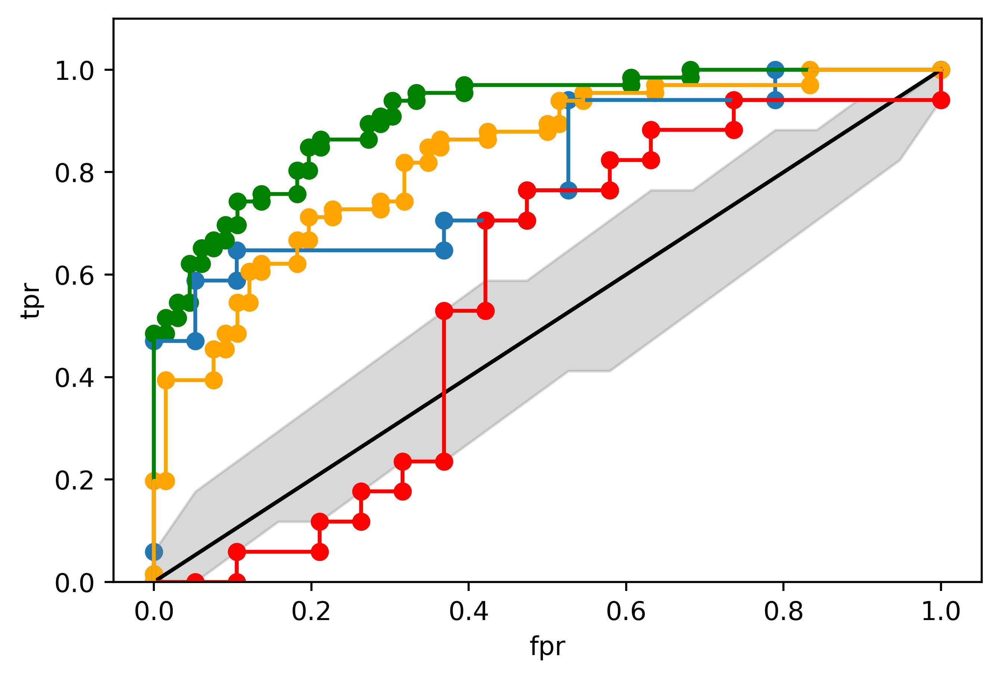

In [154]:
fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test,y_test_pred)
plt.plot(fpr,tpr)
plt.scatter(fpr,tpr)
plt.xlabel("fpr")
plt.ylabel("tpr")
plt.ylim((0,1.1))
plt.plot([0,1],[0,1],color="black")

fprs = np.array([])
for fpr,tpr in fprs_tprs:
    fprs = np.concatenate((fprs,fpr))
fprs = list(set(fprs))    
print(fprs)
matched_vals = {fpr:[] for fpr in fprs}

for fpr,tpr in fprs_tprs:
    for f,t in zip(fpr,tpr):
        matched_vals[f].append(t)
        
matched_vals = {f:[np.percentile(val,25),np.percentile(val,75)] for f,val in matched_vals.items()}
fpr_rand = list(matched_vals.keys())
fpr_rand.sort()
tpr_min = [matched_vals[f][0] for f in fpr_rand]
tpr_max = [matched_vals[f][1] for f in fpr_rand]

plt.fill_between(fpr_rand,tpr_min,tpr_max,facecolor="grey",color="grey",alpha=.3)


fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_test_baseline,pred_baseline)
plt.plot(fpr,tpr,c="red")
plt.scatter(fpr,tpr,c="red")


fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_train,y_pred_train)
plt.plot(fpr,tpr,c="green")
plt.scatter(fpr,tpr,c="green")

fpr,tpr,thresolds = sklearn.metrics.roc_curve(y_cv,y_pred_cv)
plt.plot(fpr,tpr,c="orange")
plt.scatter(fpr,tpr,c="orange")



707
314
training score:  0.8936924167257265
707
41


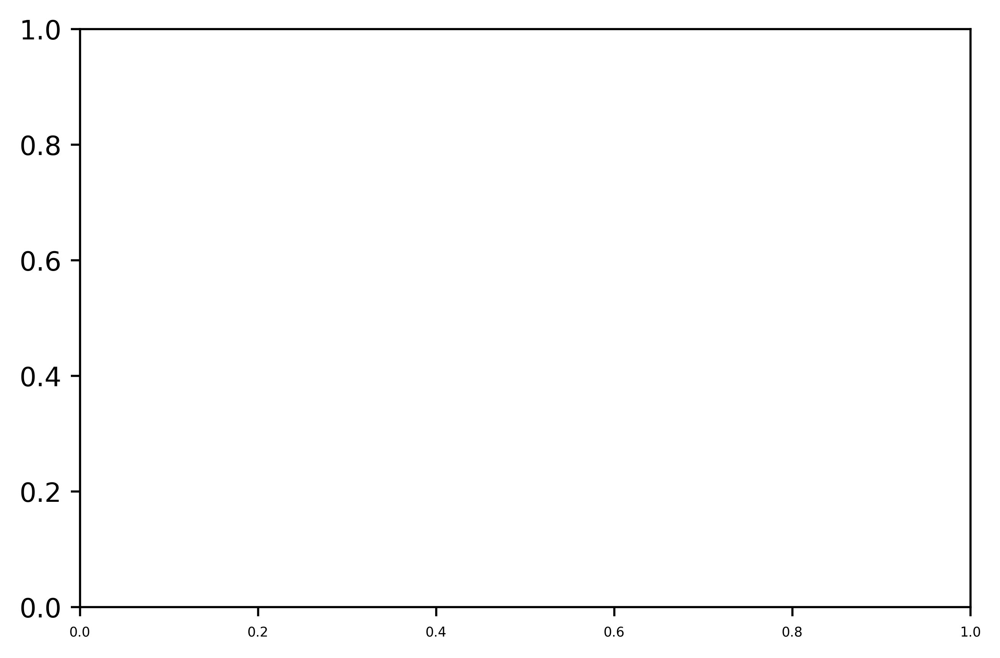

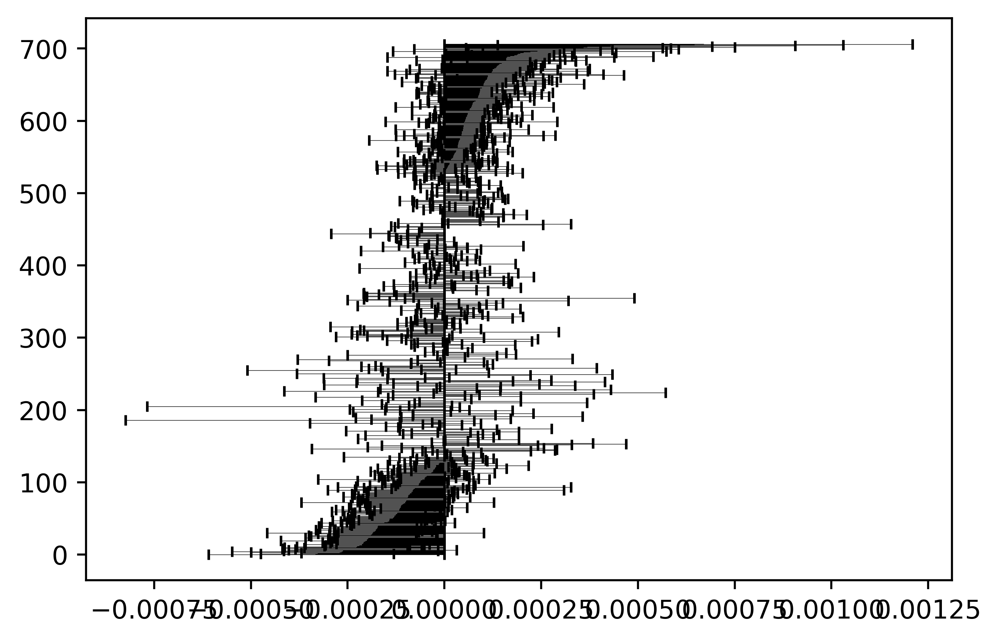

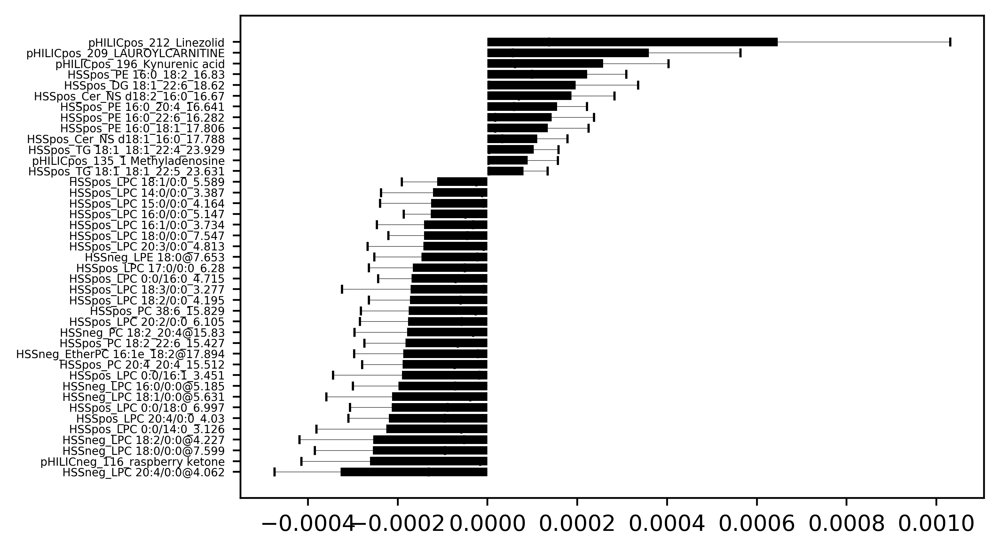

In [12]:

#train on entire dataset
X = np.concatenate((X_train,X_test))
y = np.concatenate((y_train,y_test))
X_blank = X_train_blank

    
plt.figure()
feat_params = params["feat_selection"]
selected_feats = helper.featureSelection(X,y,X_blank,mol_names,feat_params,True,True)


#bootstrap samples
poss = list(range(len(X)))
numBoots = 10000
coefs = np.zeros((numBoots,len(mol_names)))
for x in range(numBoots):
    samp = rd.choices(poss,k=len(poss))
    X_temp = X[samp]
    y_temp = y[samp]
    obj = trainFunc(X_temp,y_temp,X_blank,mol_names,params)
    coefs[x][obj._selectedvars] = np.array(flatten(obj.coef_.tolist()))
    coefs[x] = np.array([coefs[x][i]/np.median(X_temp[:,i]) for i in range(len(mol_names))])
coefs = np.array(coefs).transpose()
print(len(coefs))

coefs_ci = np.array([(np.percentile(x,2.5),np.percentile(x,97.5)) for x in coefs])

print(len(selected_feats))
obj = trainFunc(X, y, X_blank, mol_names, params)
y_pred = predictFunc(obj,X)
err_train = helper.score(y_pred,y)
print("training score: ",err_train)
#print(sklearn.metrics.confusion_matrix(y,y_pred))
plt.xticks(fontsize=5)
plt.figure()


var_imp = np.zeros((len(mol_names)))
var_imp[obj._selectedvars] = np.array(flatten(obj.coef_.tolist()))
var_imp = np.array([var_imp[x]/np.median(X[:,x]) for x in range(len(var_imp))])

coefs_ci_normed = np.array([np.abs(r - vi) for r,vi in zip(coefs_ci,var_imp)])
print(len(var_imp))
order = list(range(len(var_imp)))
order.sort(key=lambda x:var_imp[x])
var_imp = var_imp[order]
coefs = coefs[order]
coefs_ci = coefs_ci[order]
coefs_ci_normed = coefs_ci_normed[order]

plt.barh(range(len(var_imp)),width = var_imp,xerr=[coefs_ci_normed[:,0],coefs_ci_normed[:,1]],ecolor="black",capsize=2,error_kw={"elinewidth":0.2,"barsabove":False},color="black")

plt.figure()

#filter out feats passing zero

goodMets = []
for x in range(len(coefs)):
    if coefs_ci[x][0] * coefs_ci[x][1] > 0:
        goodMets.append(x)
        
mol_names_sorted = mol_names[order]

plt.barh(range(len(goodMets)),width = var_imp[goodMets],xerr=[coefs_ci_normed[goodMets,0],coefs_ci_normed[goodMets,1]],ecolor="black",capsize=2,error_kw={"elinewidth":0.2,"barsabove":False},color="black")

plt.yticks(range(len(goodMets)),mol_names_sorted[goodMets],fontsize=5)
print(len(goodMets))


130


Text(0, 0.5, 'Metabolite')

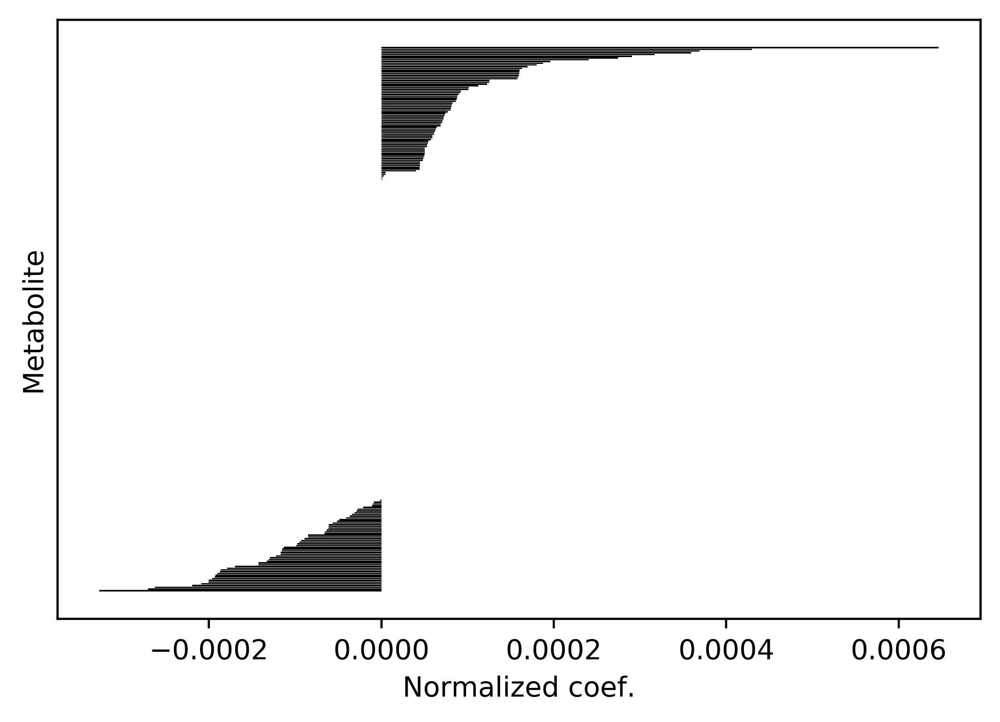

In [151]:
obj = trainFunc(X,y,X_blank,mol_names,params)
rel = var_imp[obj._selectedvars]
print(len([x for x in rel if np.abs(x) > 0]))
names = mol_names[obj._selectedvars]
o = list(range(len(rel)))
o.sort(key=lambda x:rel[x])
rel = rel[o]
names = names[o]
plt.barh(range(len(rel)),width = rel,color="black")
plt.yticks([])
plt.xlabel("Normalized coef.")
plt.ylabel("Metabolite")

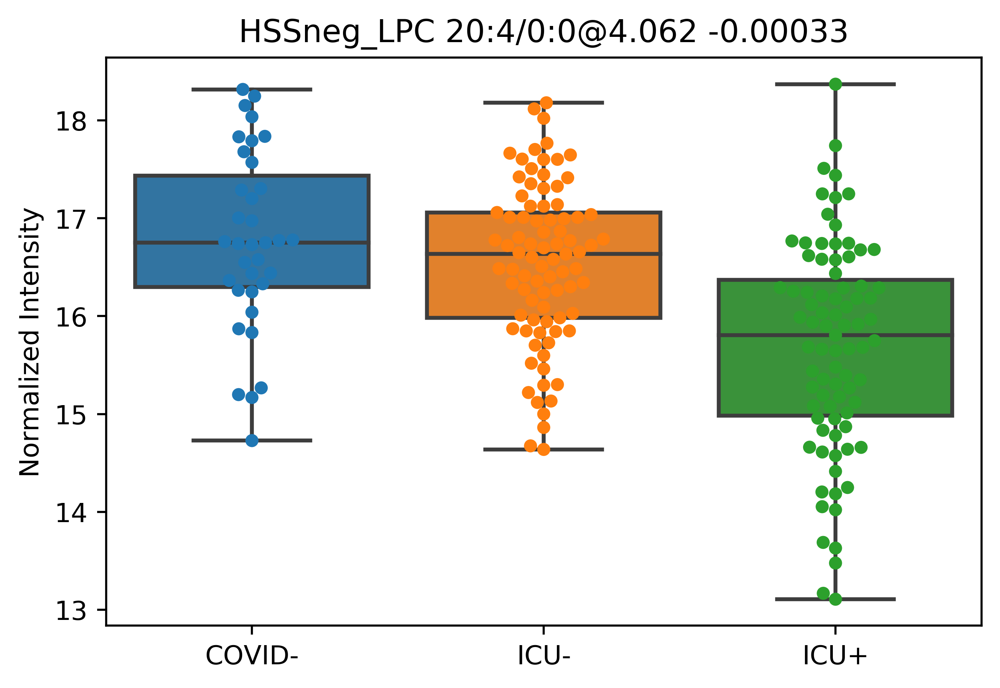

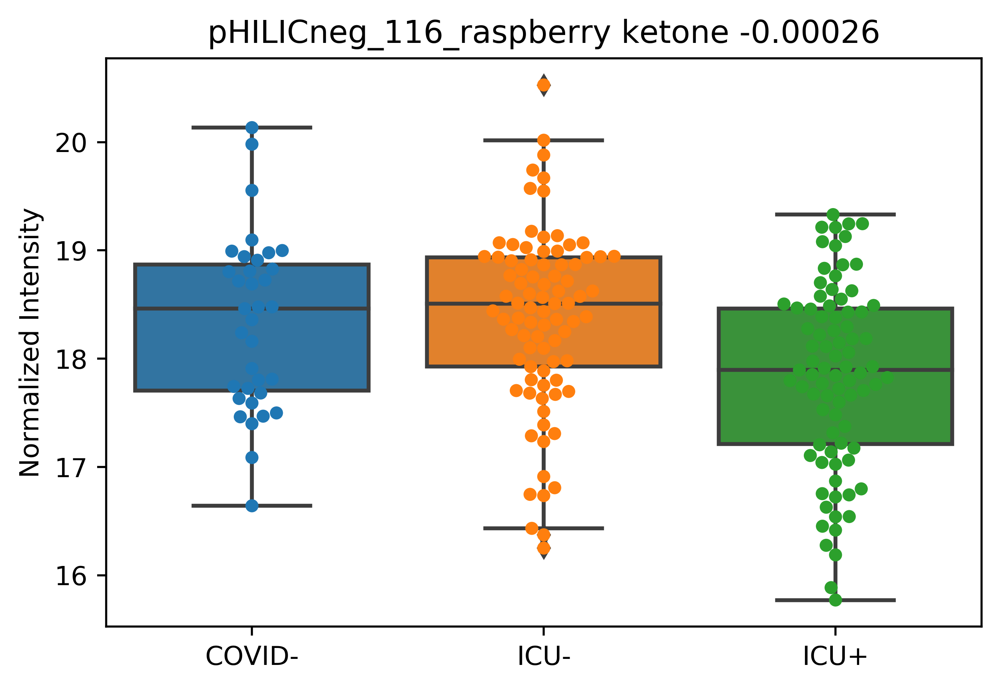

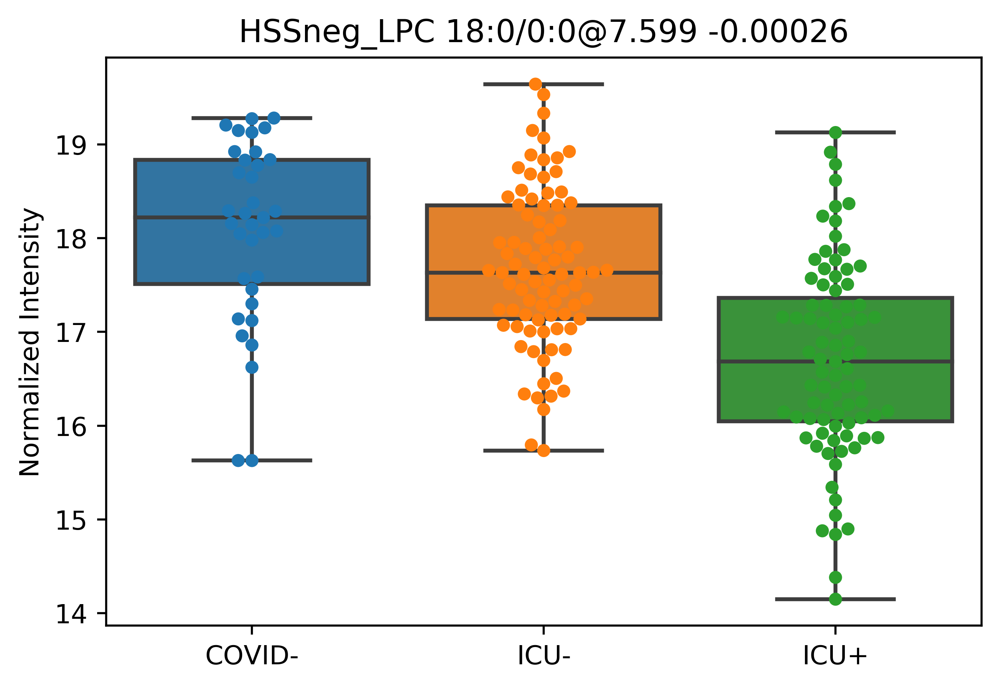

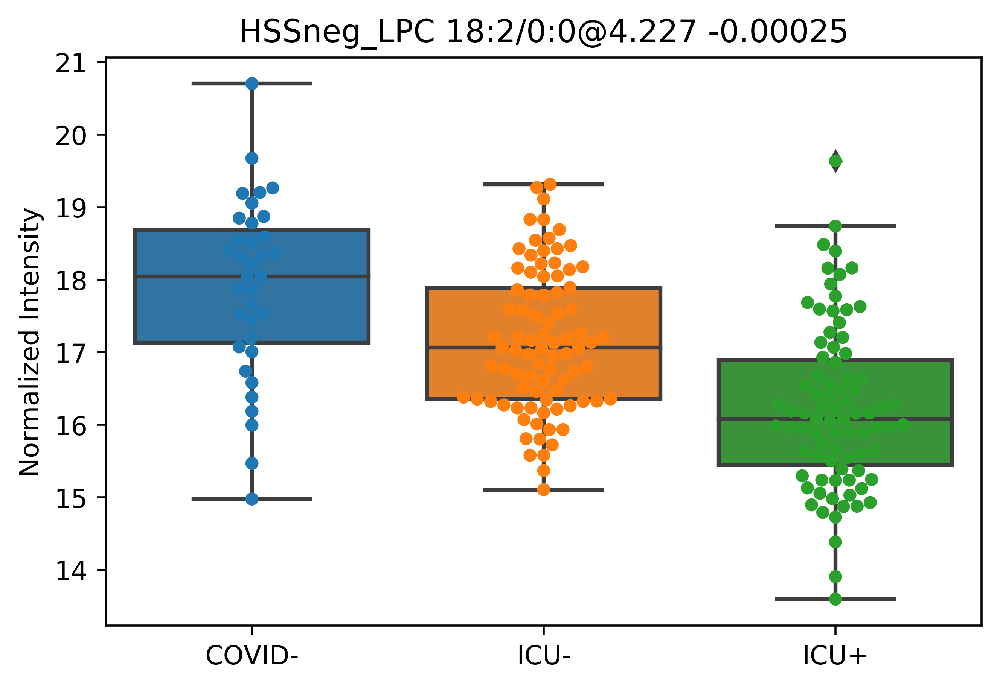

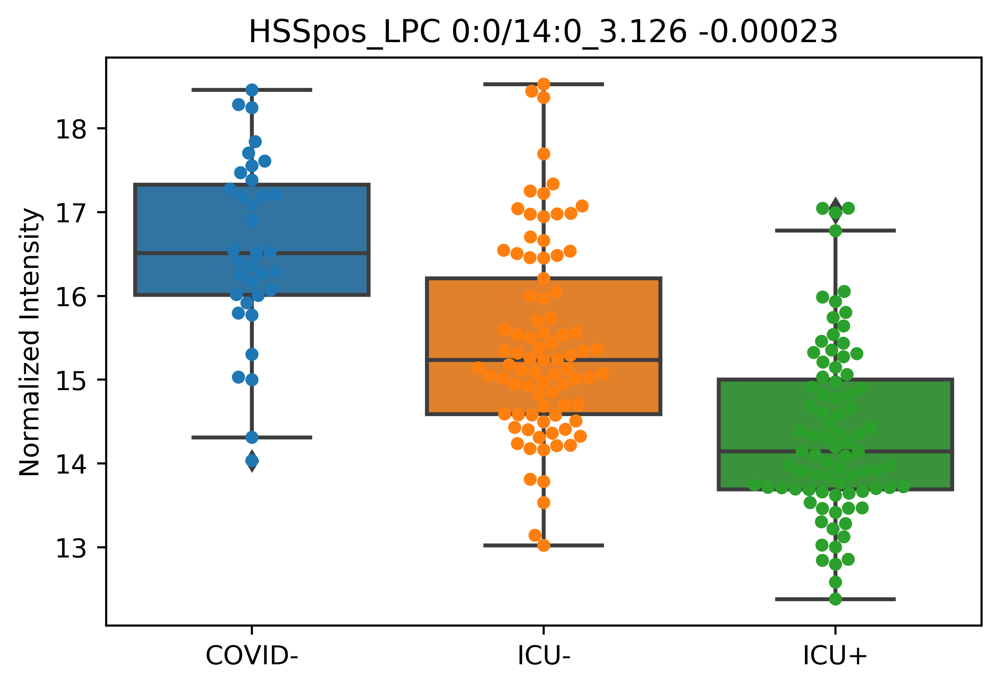

...

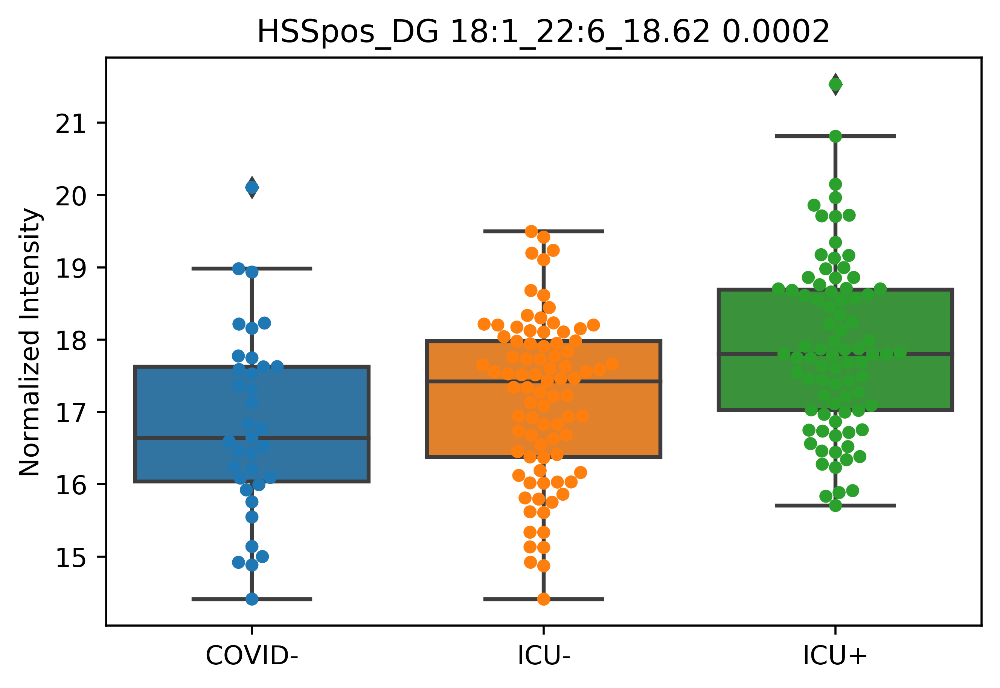

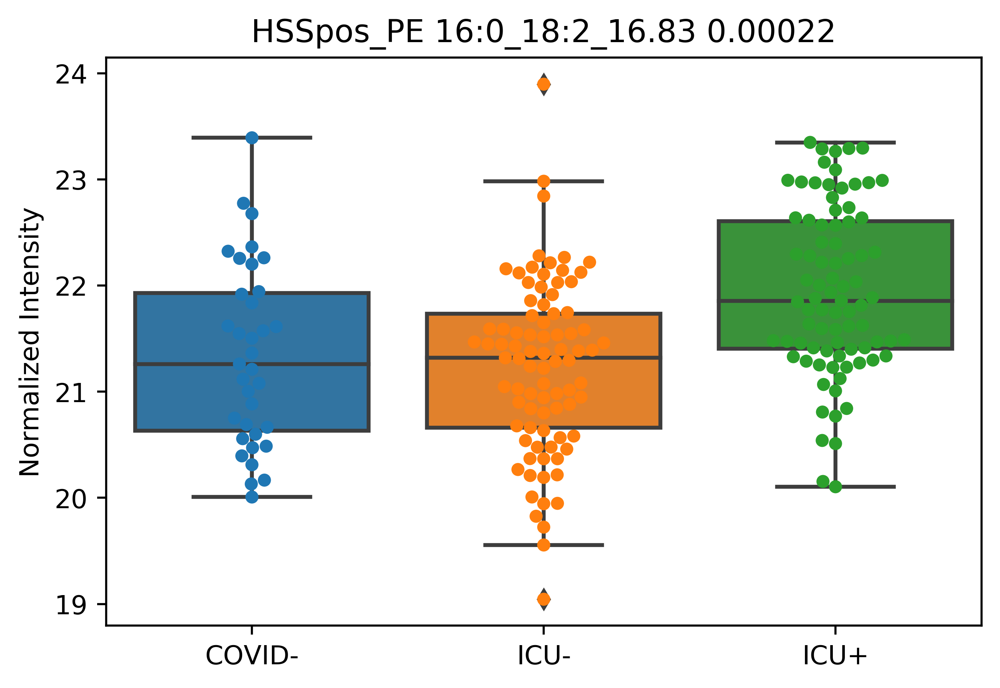

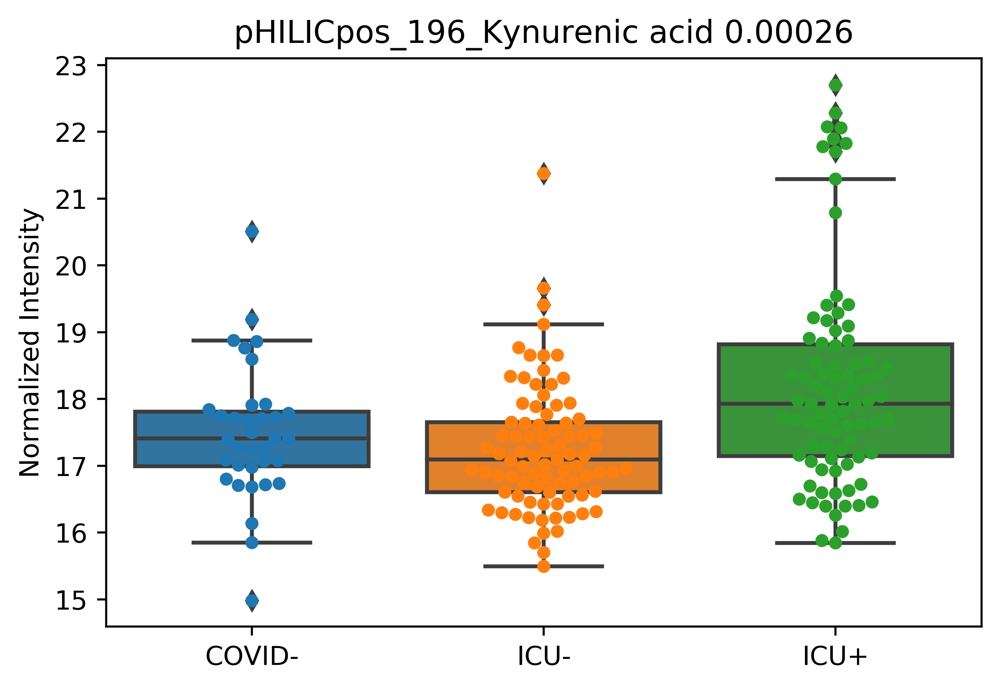

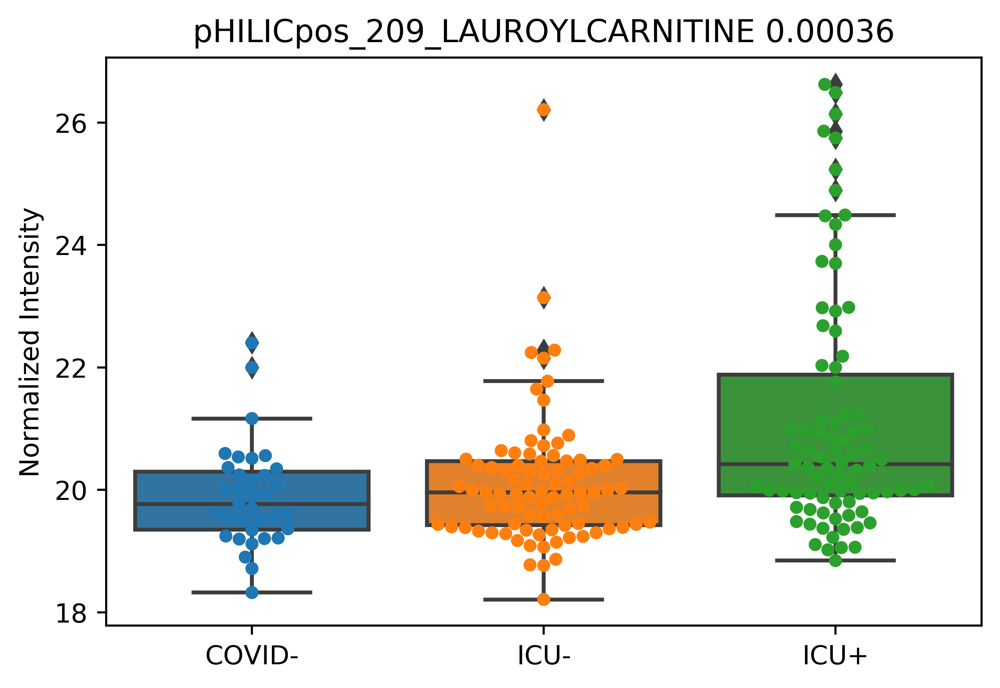

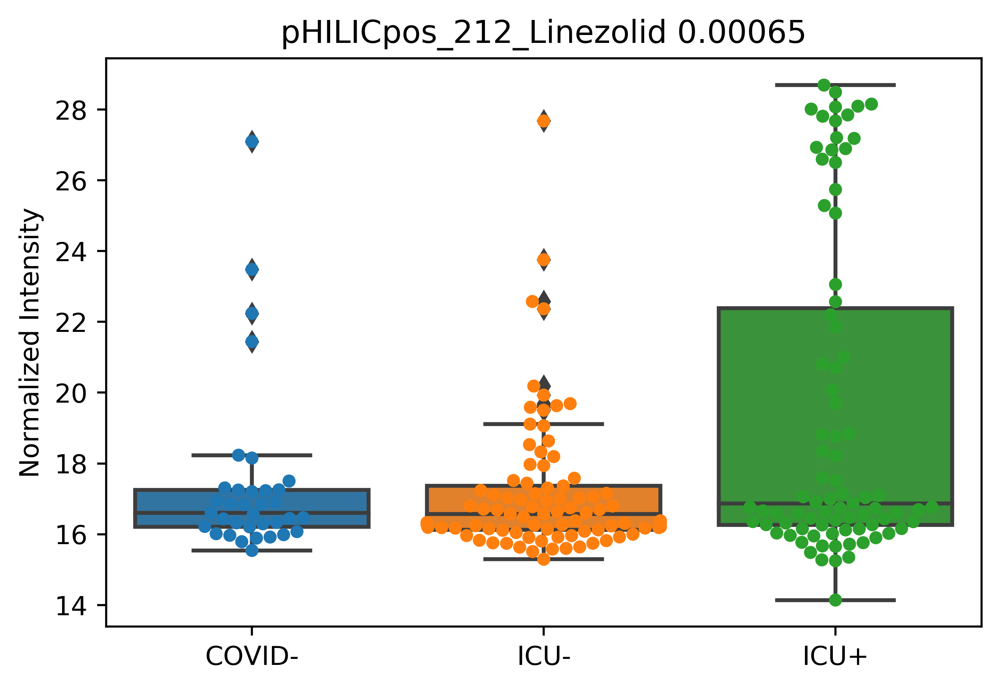

In [13]:
for met in goodMets:
    plt.figure()
    norm = 1#np.median(X[:,met])
    tempX = np.concatenate((X[:,order[met]],X_val[:,order[met]]))
    tempy = np.concatenate((y,[-1 for x in X_val]))
    tempDict = {}
    
    for x,yy,i in zip(tempX,tempy,range(len(tempX))):
        tempDict[i] = {"ICU":yy,"Normalized Intensity":x}
    tempDf = pd.DataFrame.from_dict(tempDict,orient="index")
    sb.swarmplot(data=tempDf,x="ICU",y="Normalized Intensity")
    sb.boxplot(data=tempDf,x="ICU",y="Normalized Intensity")
    plt.title(mol_names_sorted[met] + " " + str(np.round(var_imp[met],5)))
    
    plt.xticks([0,1,2],["COVID-","ICU-","ICU+"])
    plt.xlabel("")

707 compounds sig. higher in samples than blank
17 compounds sig. diff between vent+ and vent-
17 compounds sig. diff between vent+ and vent- and sig. higher than blank


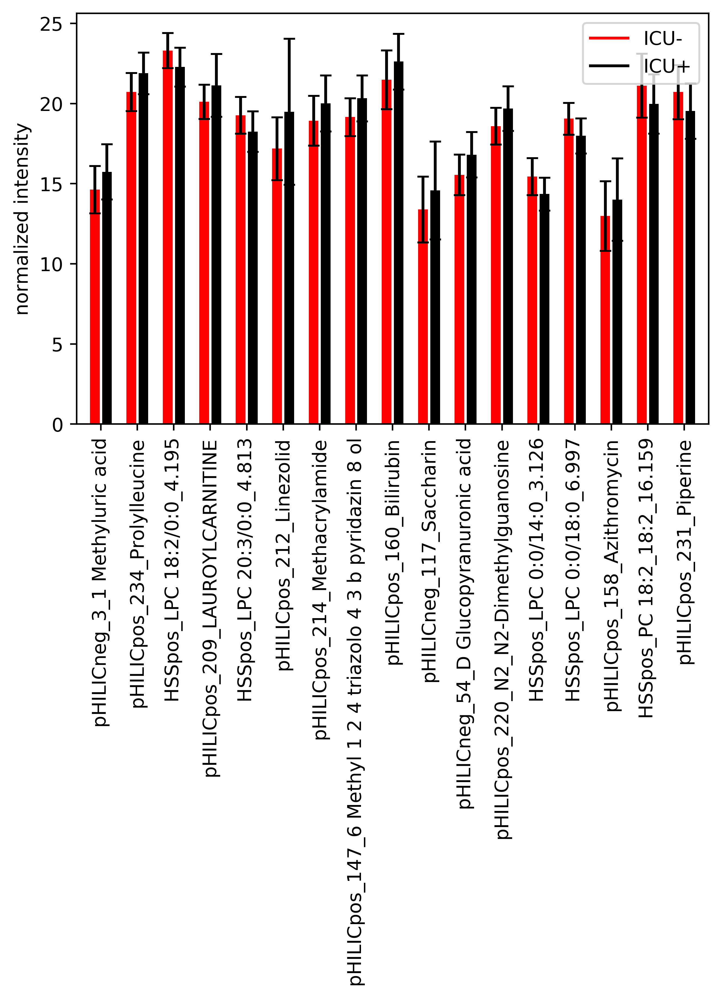

In [131]:
selected_feats = helper.featureSelection(X,y,X_blank,mol_names,["stat",0.05,2],True,True)


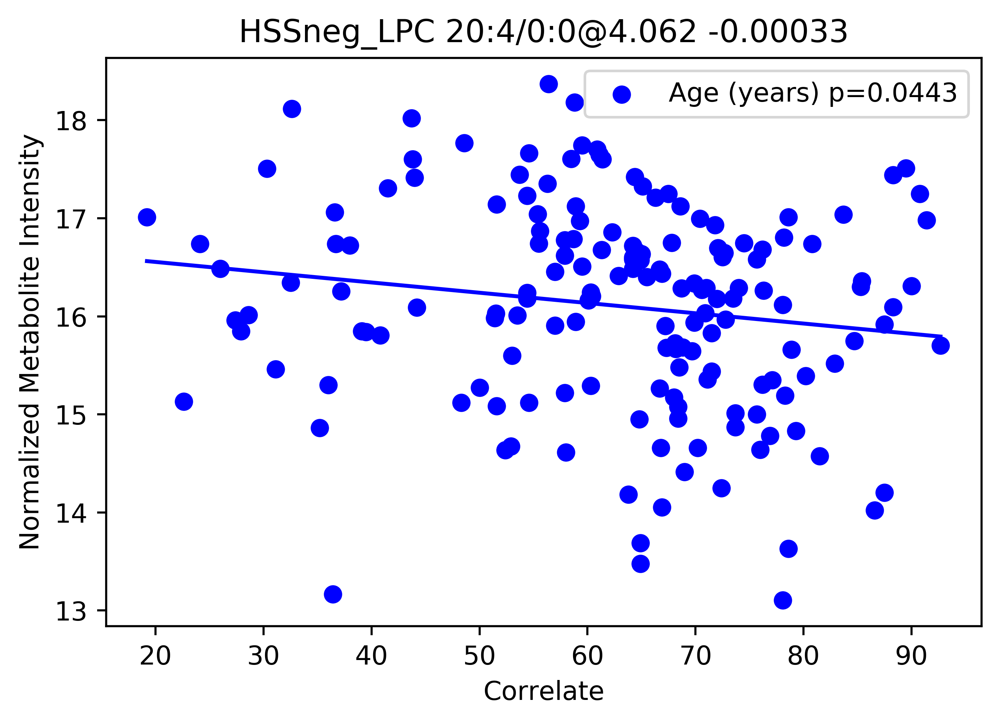

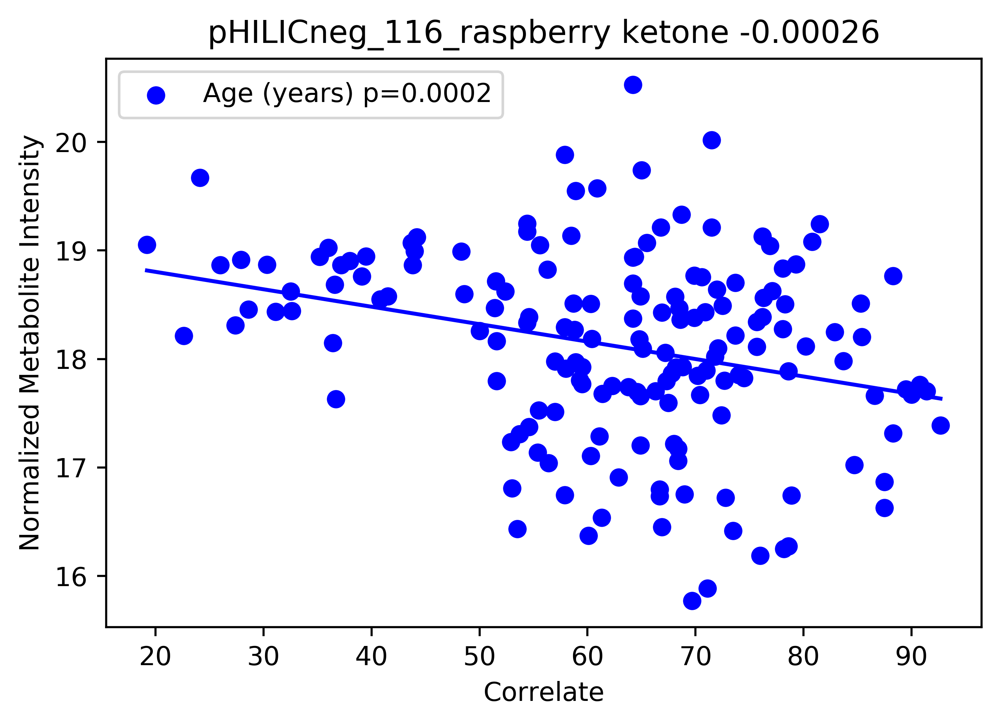

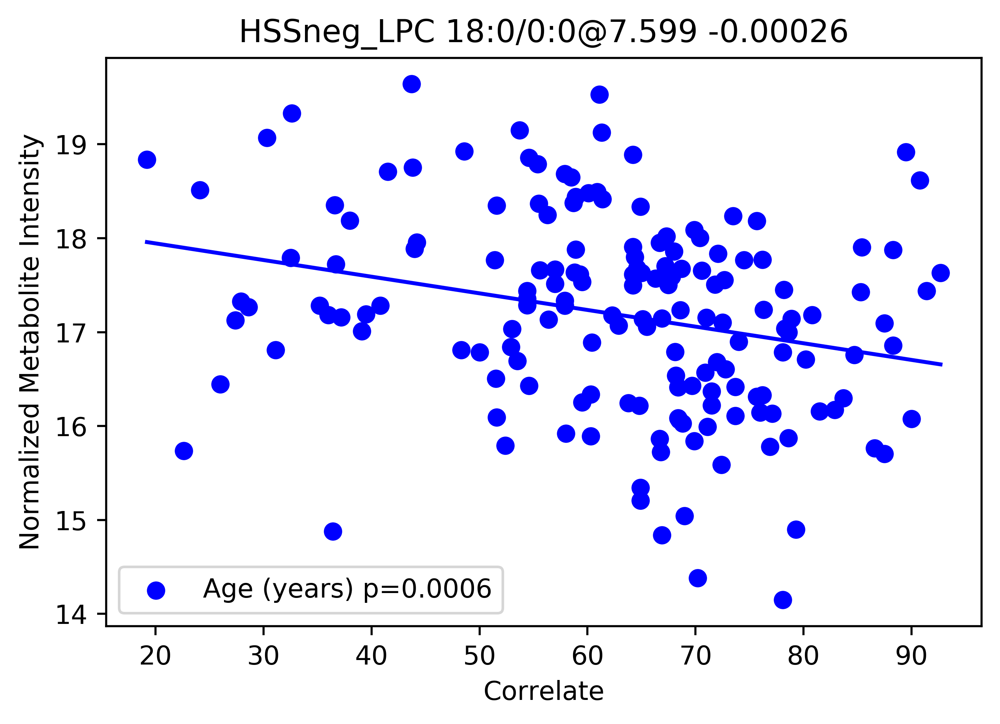

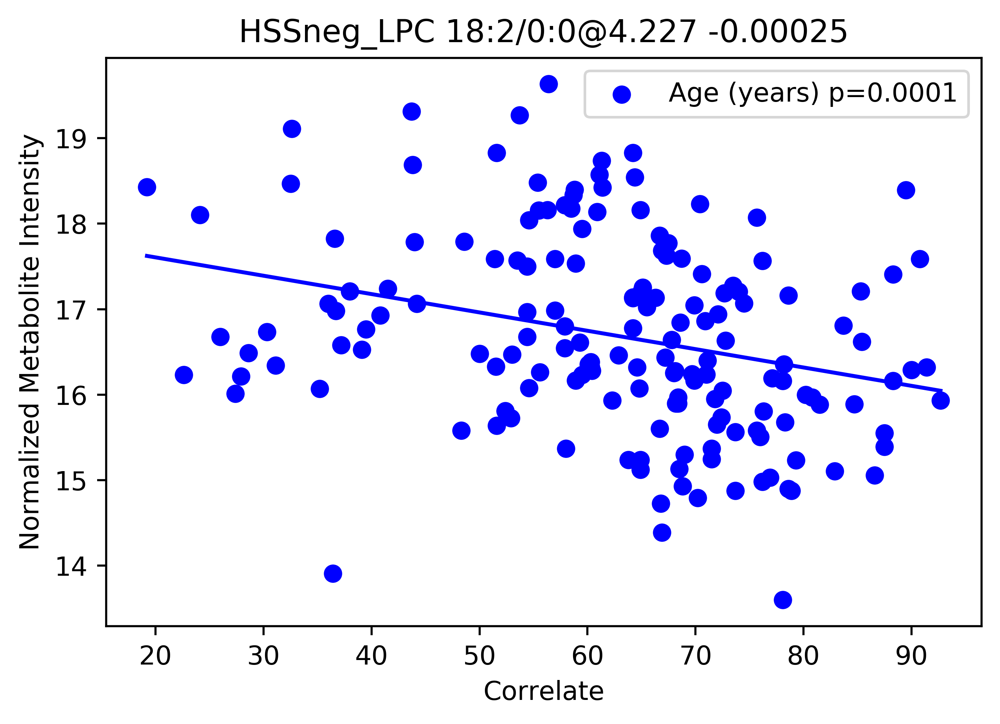

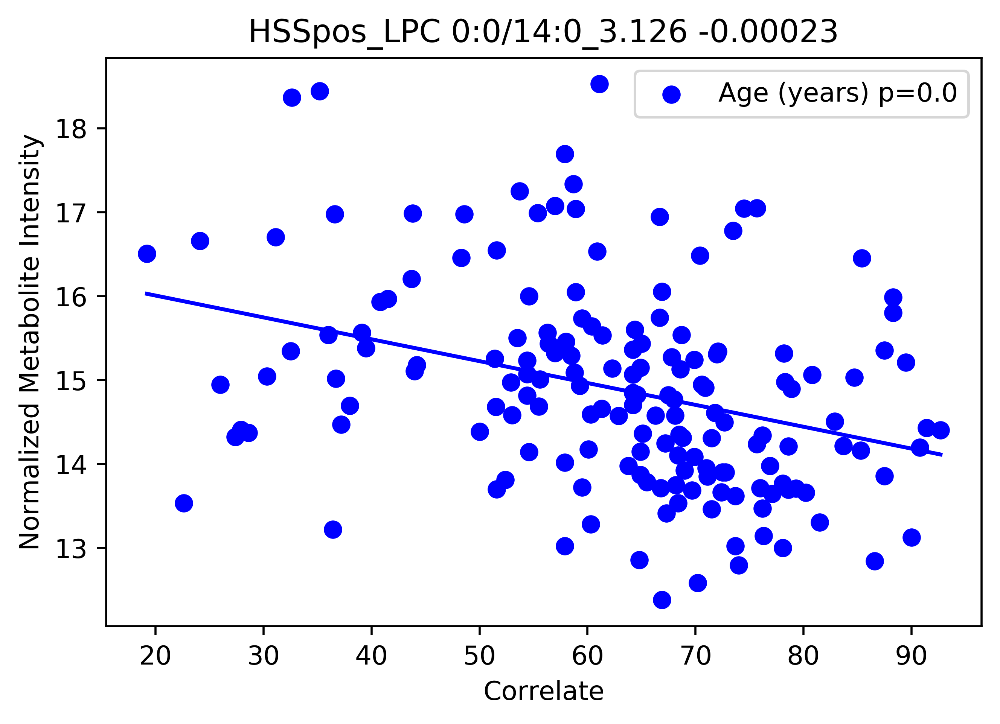

...

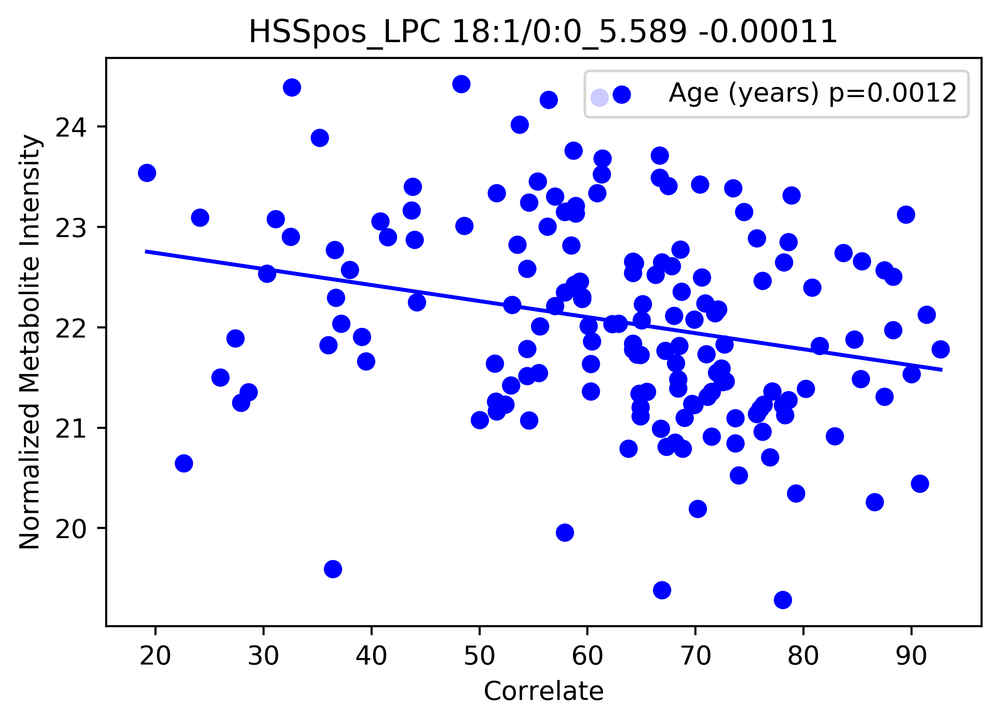

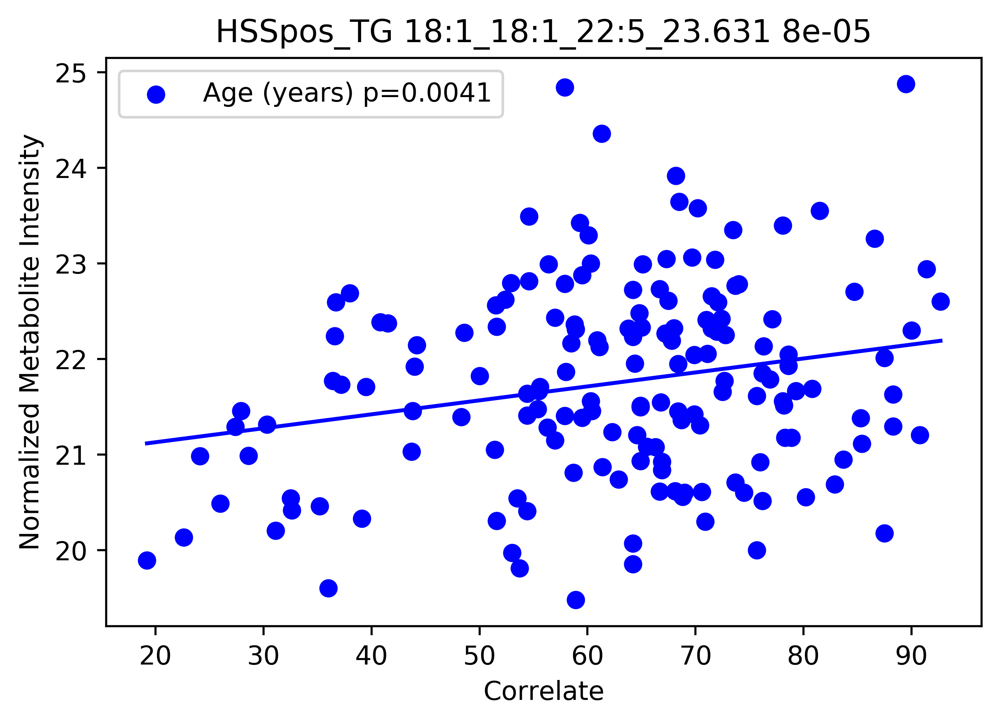

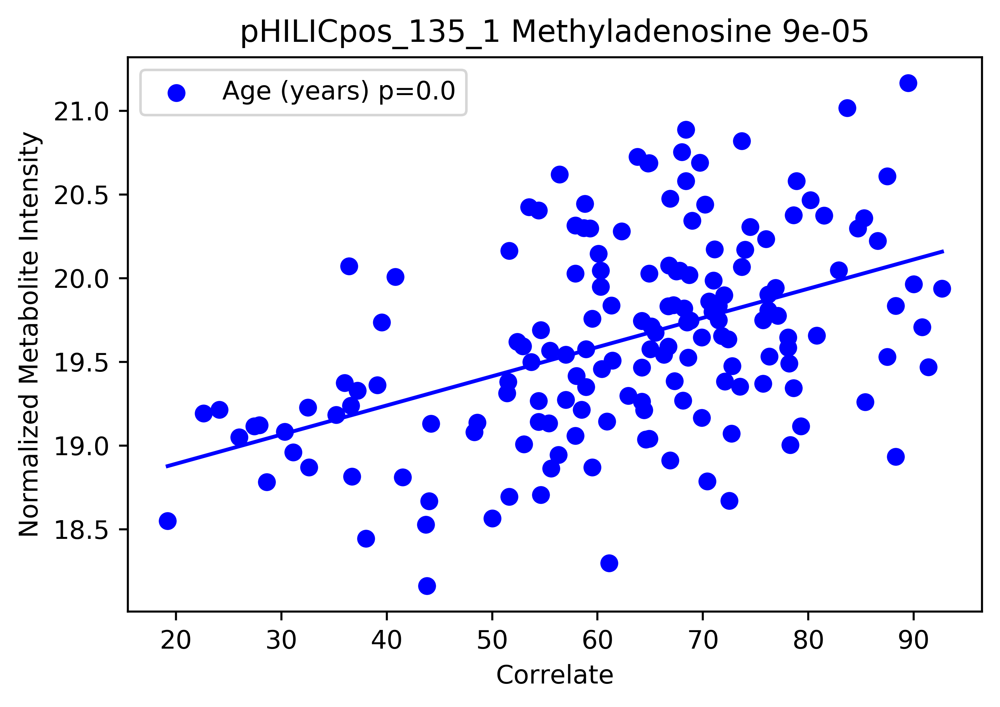

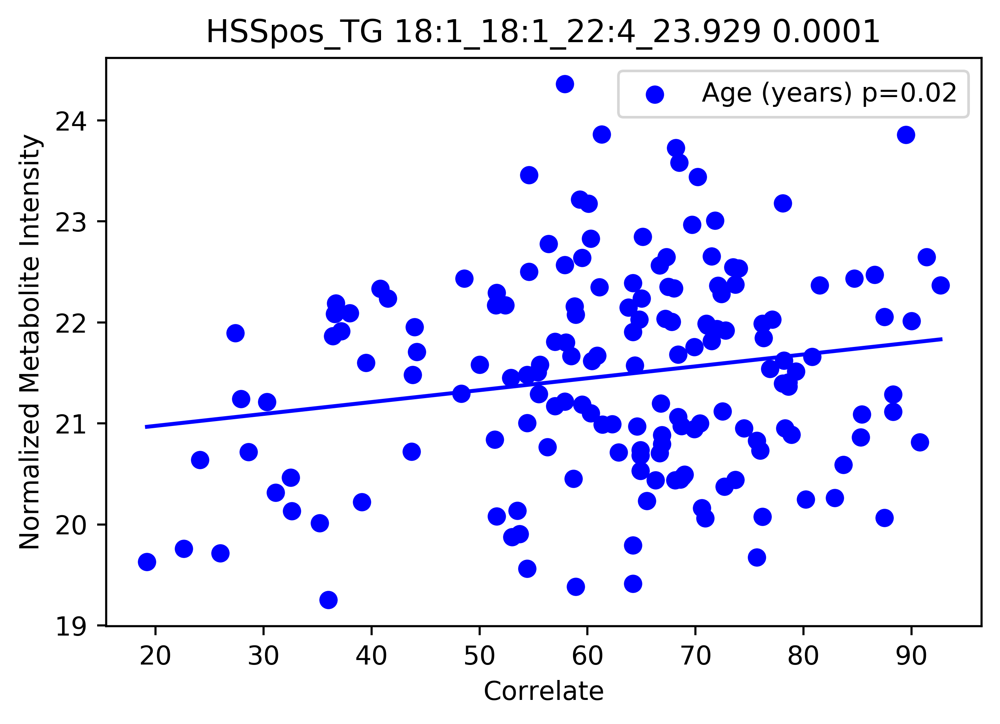

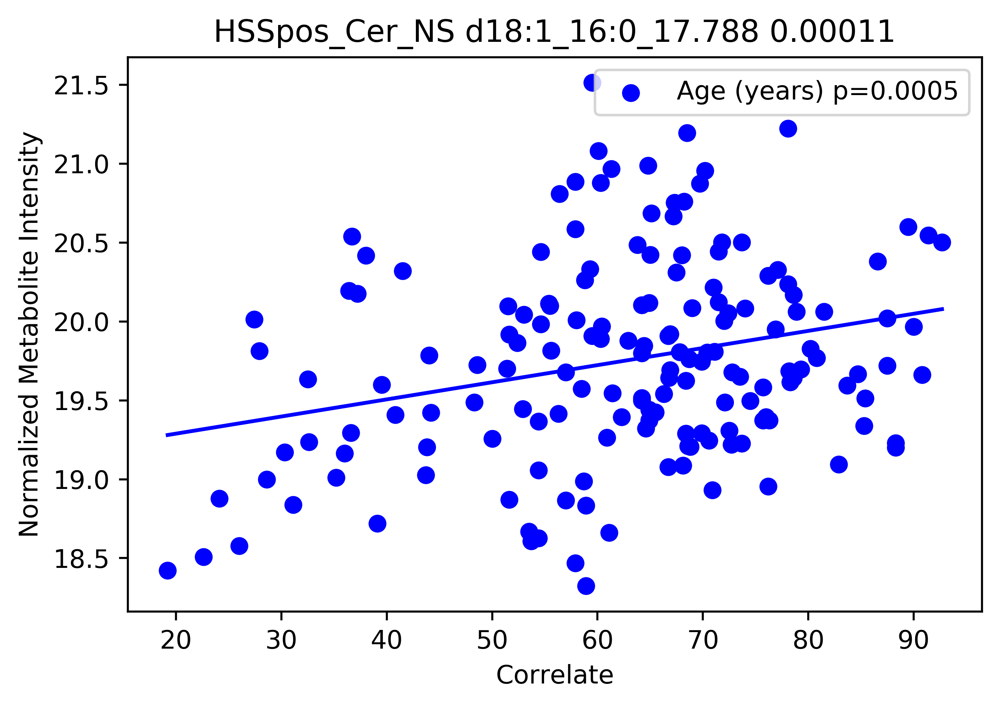

<Figure size 3000x2000 with 0 Axes>

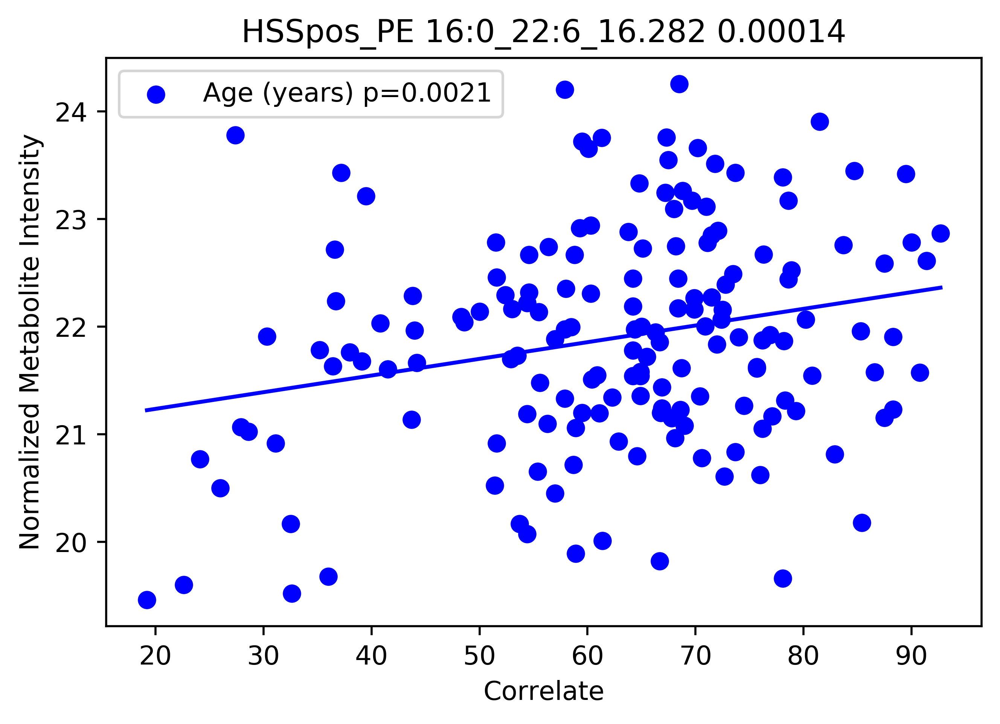

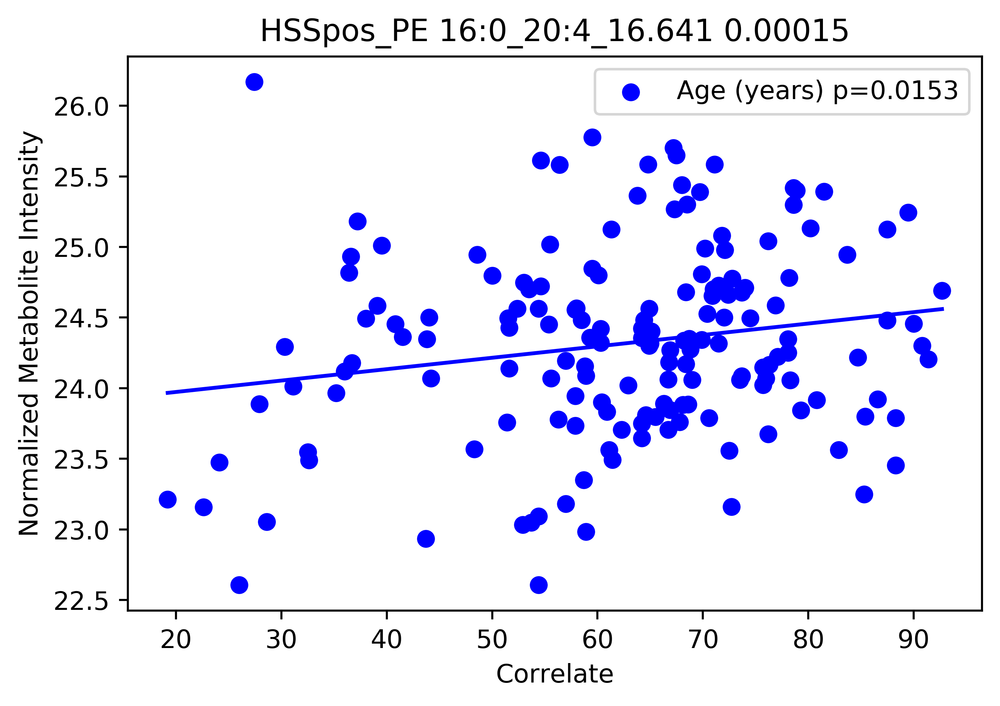

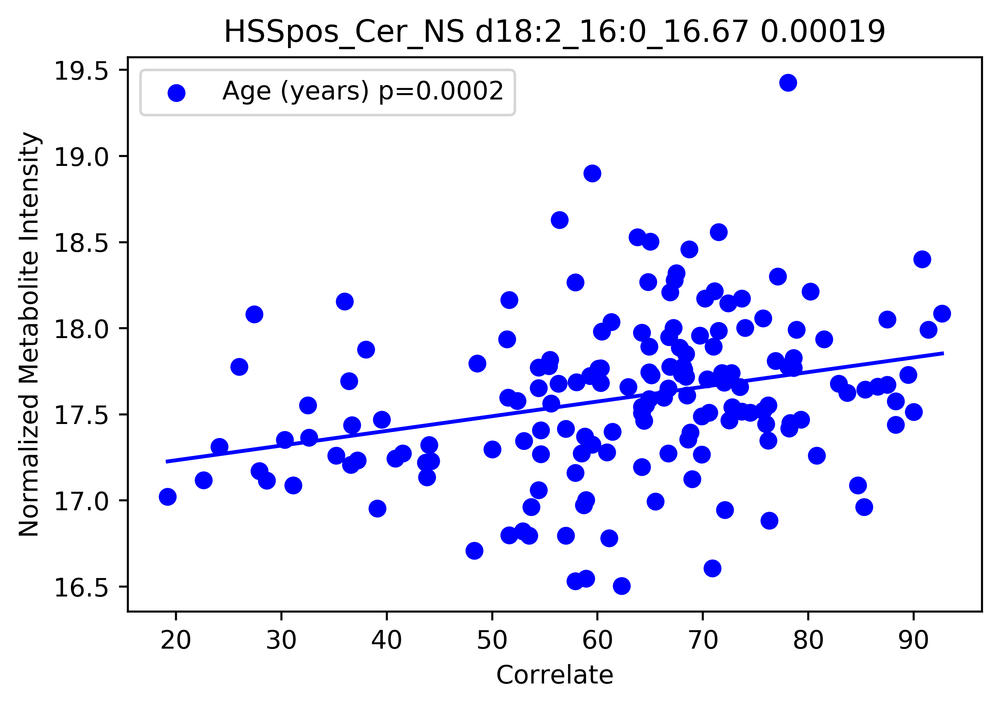

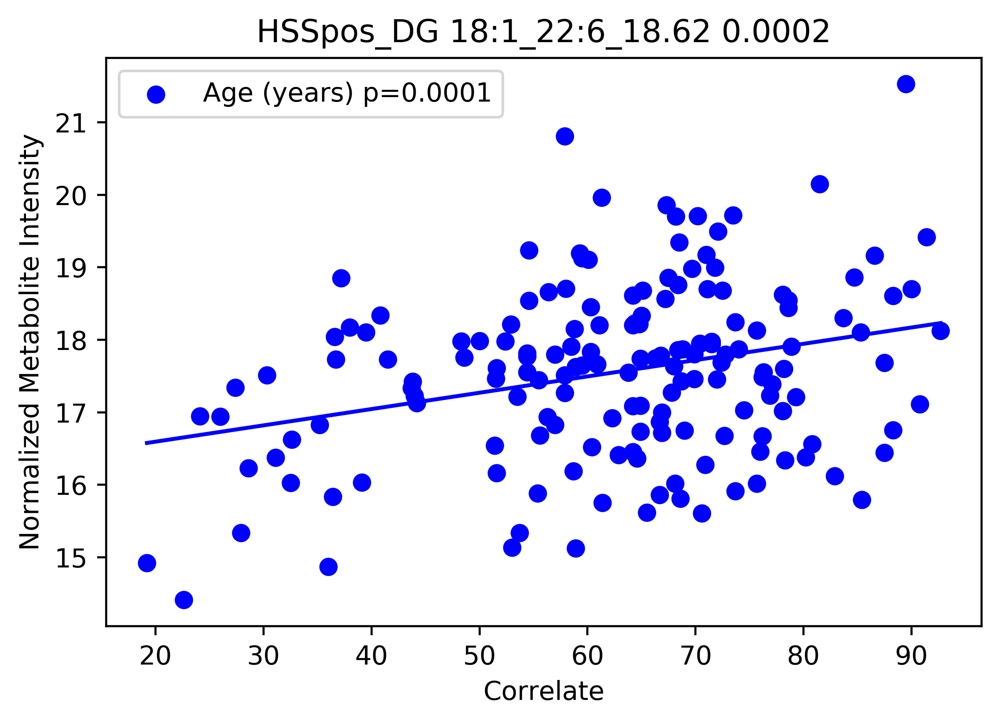

<Figure size 3000x2000 with 0 Axes>

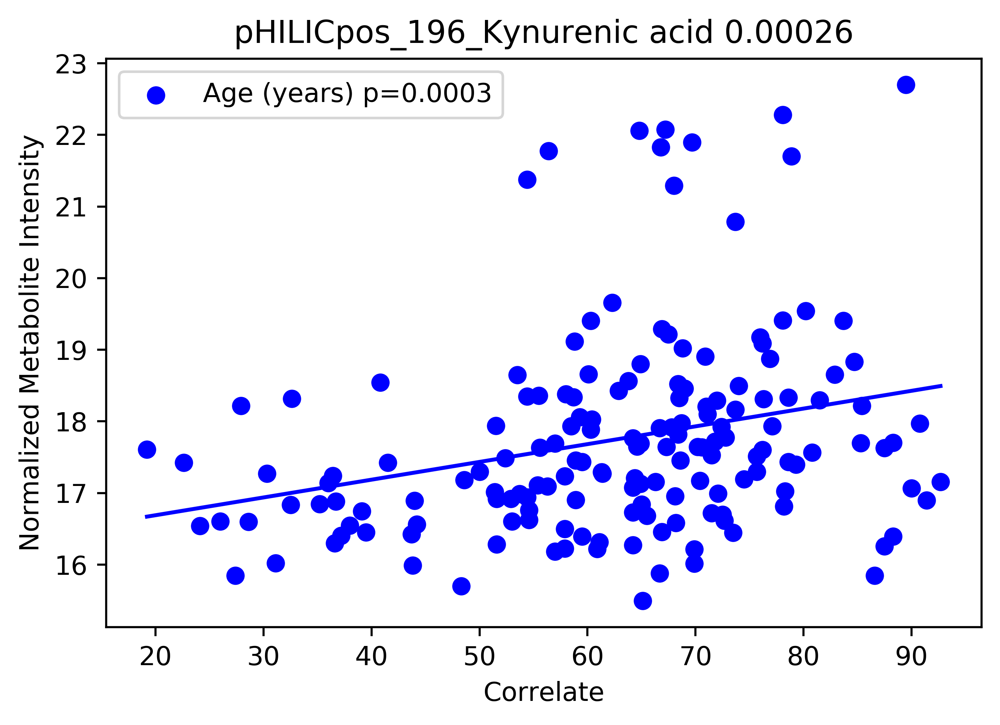

<Figure size 3000x2000 with 0 Axes>

<Figure size 3000x2000 with 0 Axes>

In [148]:
X_baseline_met = np.concatenate((X_train[good_train_ind,:],X_test[good_test_ind,:]))
not_corr = []
pval = 0.05

for met in goodMets:
    
    good=True
    plt.figure()
    tempX_age = X_baseline[:,0]
    tempX_bmi = X_baseline[:,1]

    tempy = X_baseline_met[:,order[met]]
    r,p = stats.pearsonr(tempX_age,tempy)
    
    if p < pval:
        good = False
    
        lm = sklearn.linear_model.LinearRegression(fit_intercept=True)
        lm.fit([[x] for x in tempX_age],tempy)
        xx = np.linspace(min(tempX_age),max(tempX_age),100)
        plt.plot(xx,lm.predict([[x] for x in xx]),color="blue")
        plt.scatter(tempX_age,tempy,label="Age (years) p=" + str(np.round(p,4)) ,color="blue") 


#     lm.fit([[x] for x in tempX_bmi],tempy)
#     xx = np.linspace(min(tempX_bmi),max(tempX_bmi),100)
#     r,p = stats.pearsonr(tempX_bmi,tempy)
    
#     if p < pval:
#         good = False
#         plt.plot(xx,lm.predict([[x] for x in xx]),color="orange")
#         plt.scatter(tempX_bmi,tempy,label="BMI p="+ str(np.round(p,4)),color="orange")

    if good:
        not_corr.append(met)
    else:
        plt.title(mol_names_sorted[met] + " " + str(np.round(var_imp[met],5)))
        plt.xlabel("Correlate")
        plt.ylabel("Normalized Metabolite Intensity")
        plt.legend()

4


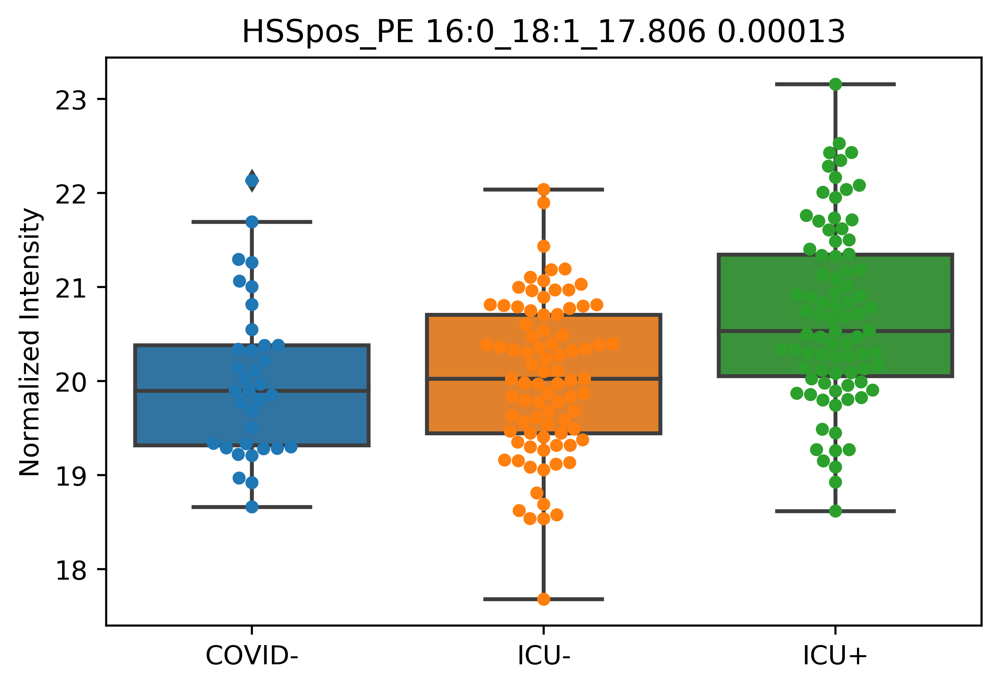

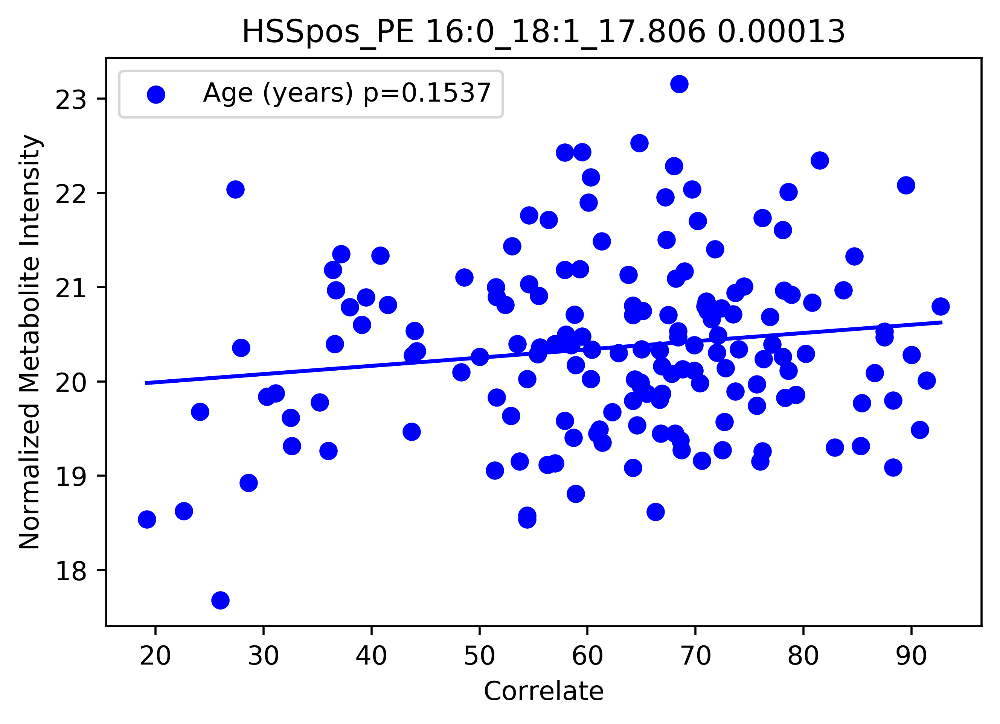

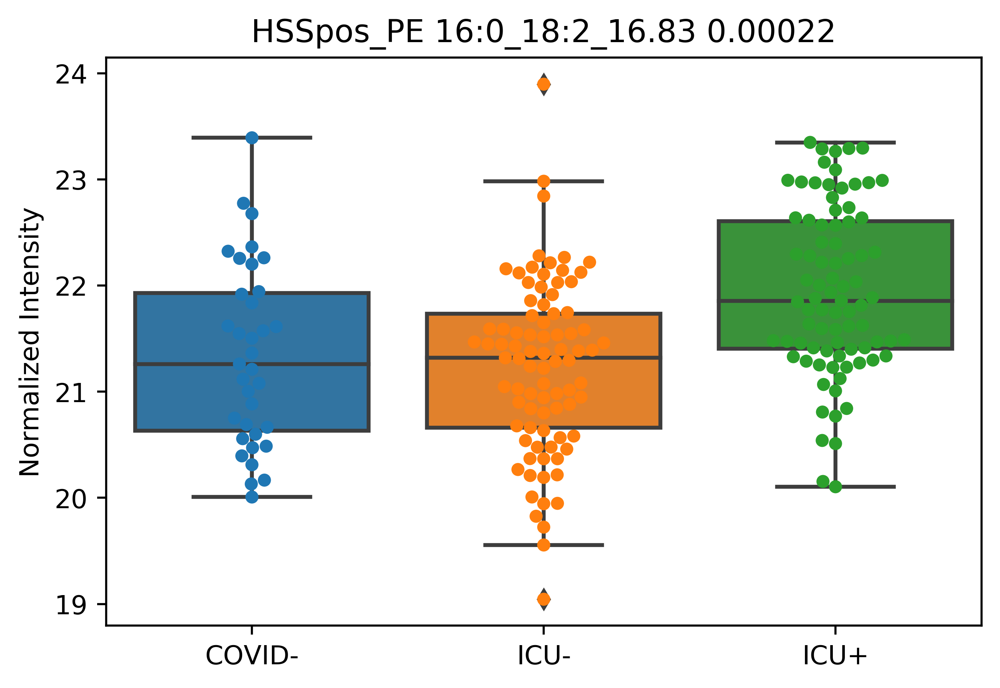

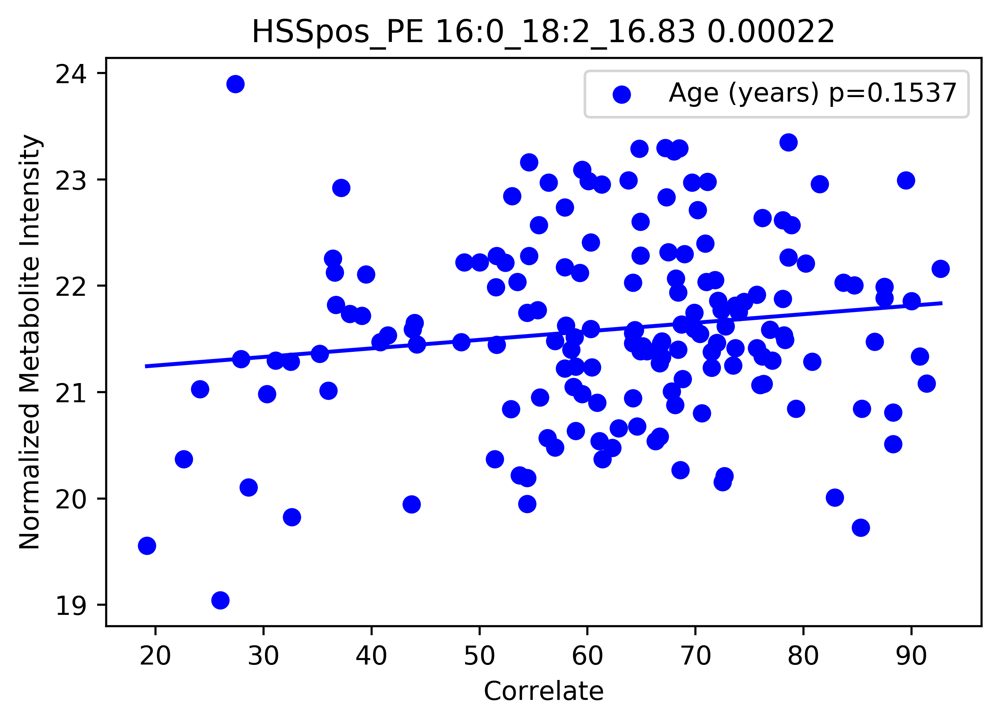

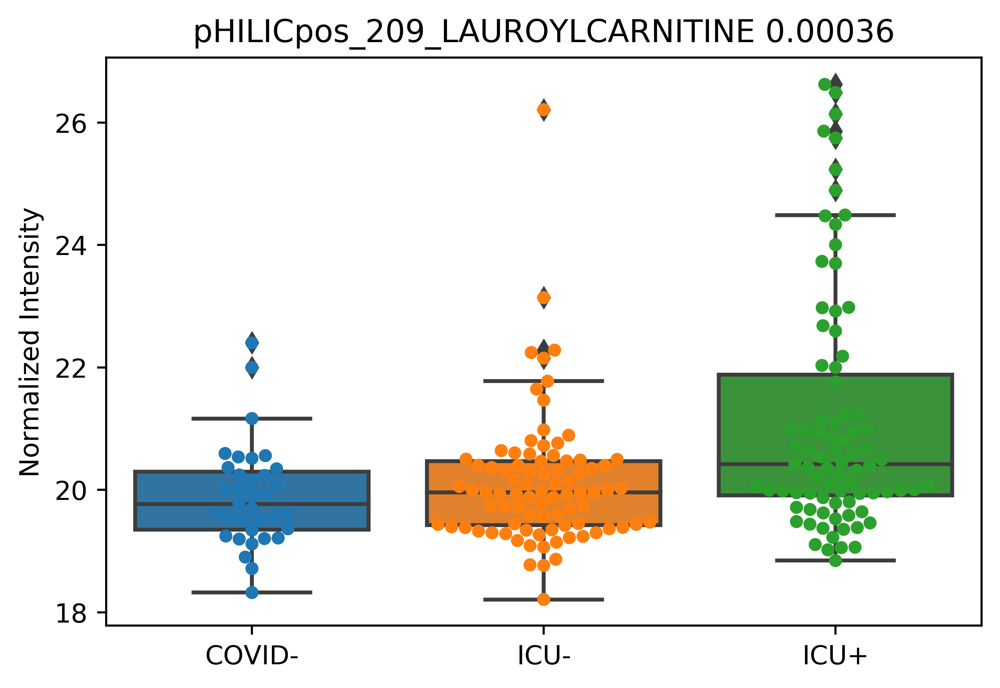

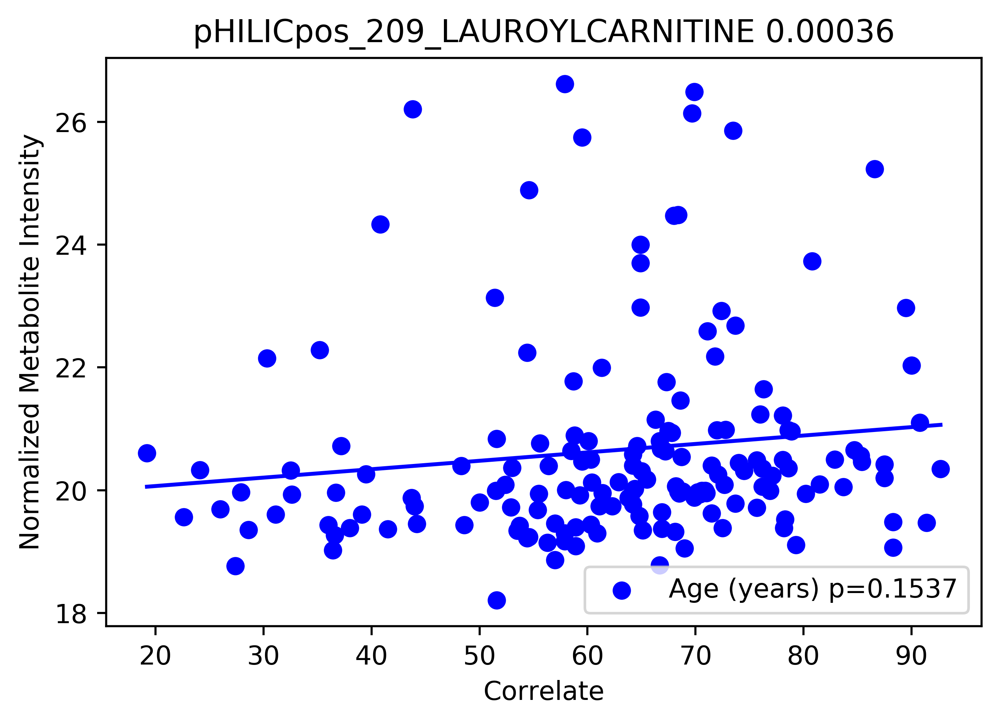

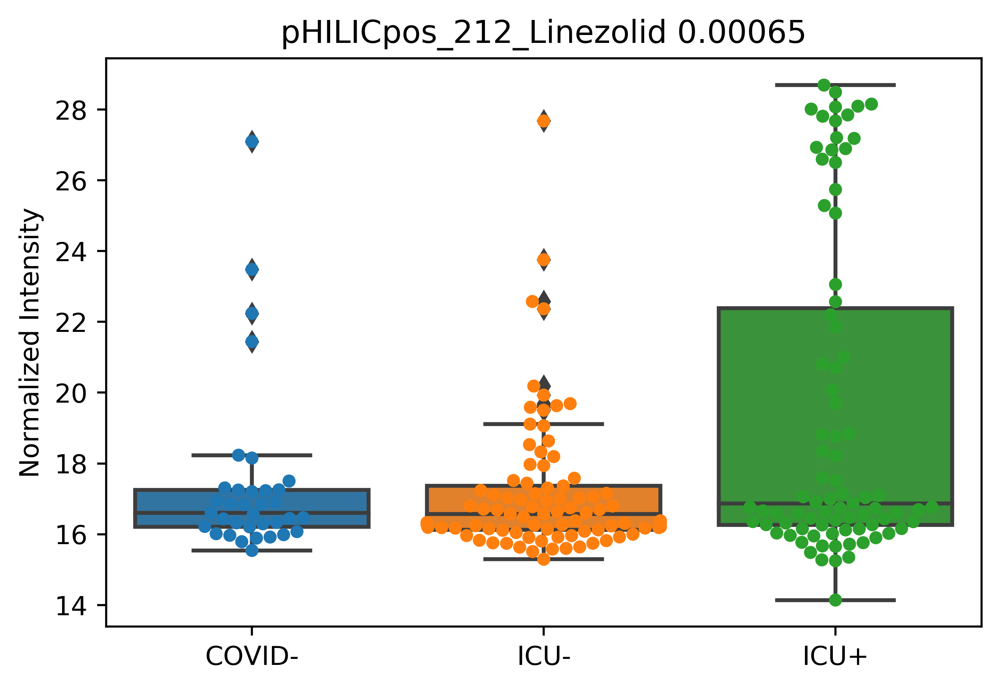

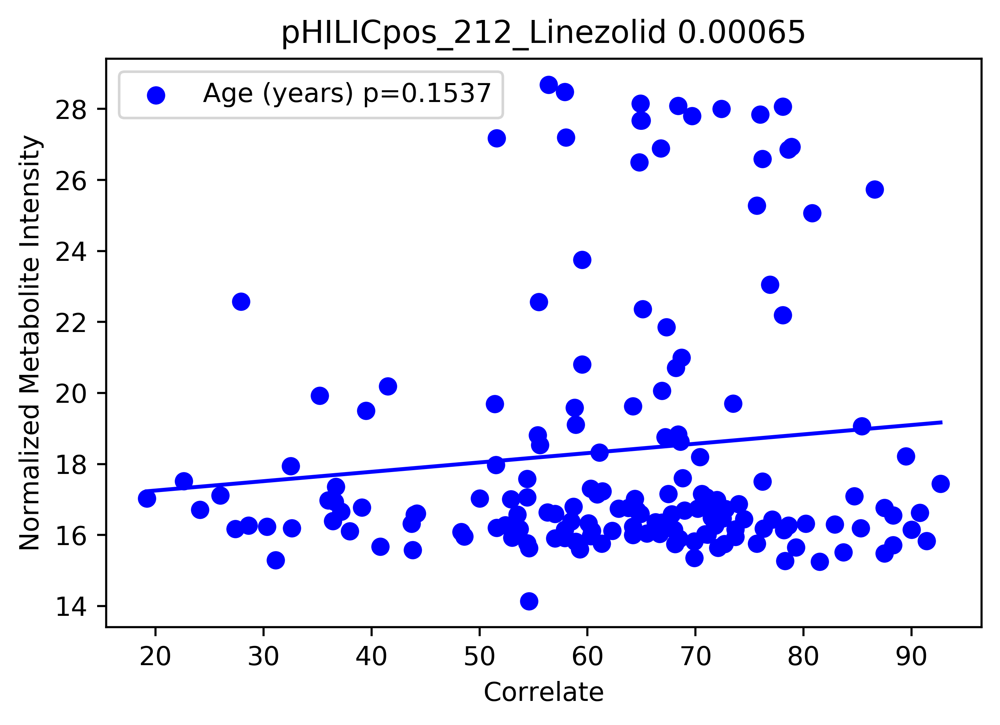

In [150]:
print(len(not_corr))
for met in not_corr:
    plt.figure()
    norm = 1#np.median(X[:,met])
    tempX = np.concatenate((X[:,order[met]],X_val[:,order[met]]))
    tempy = np.concatenate((y,[-1 for x in X_val]))
    tempDict = {}
    
    for x,yy,i in zip(tempX,tempy,range(len(tempX))):
        tempDict[i] = {"ICU":yy,"Normalized Intensity":x}
    tempDf = pd.DataFrame.from_dict(tempDict,orient="index")
    sb.swarmplot(data=tempDf,x="ICU",y="Normalized Intensity")
    sb.boxplot(data=tempDf,x="ICU",y="Normalized Intensity")
    plt.title(mol_names_sorted[met] + " " + str(np.round(var_imp[met],5)))
    
    plt.xticks([0,1,2],["COVID-","ICU-","ICU+"])
    plt.xlabel("")
    
    plt.figure()
    
    tempX_age = X_baseline[:,0]
    tempX_bmi = X_baseline[:,1]

    tempy = X_baseline_met[:,order[met]]
    

    lm = sklearn.linear_model.LinearRegression(fit_intercept=True)
    lm.fit([[x] for x in tempX_age],tempy)
    xx = np.linspace(min(tempX_age),max(tempX_age),100)
    plt.plot(xx,lm.predict([[x] for x in xx]),color="blue")
    plt.scatter(tempX_age,tempy,label="Age (years) p=" + str(np.round(p,4)) ,color="blue") 


#     lm.fit([[x] for x in tempX_bmi],tempy)
#     xx = np.linspace(min(tempX_bmi),max(tempX_bmi),100)
#     r,p = stats.pearsonr(tempX_bmi,tempy)
    
    
#     plt.plot(xx,lm.predict([[x] for x in xx]),color="orange")
#     plt.scatter(tempX_bmi,tempy,label="BMI p="+ str(np.round(p,4)),color="orange")

    plt.title(mol_names_sorted[met] + " " + str(np.round(var_imp[met],5)))
    plt.xlabel("Correlate")
    plt.ylabel("Normalized Metabolite Intensity")
    plt.legend()

Text(0.5, 0, '')

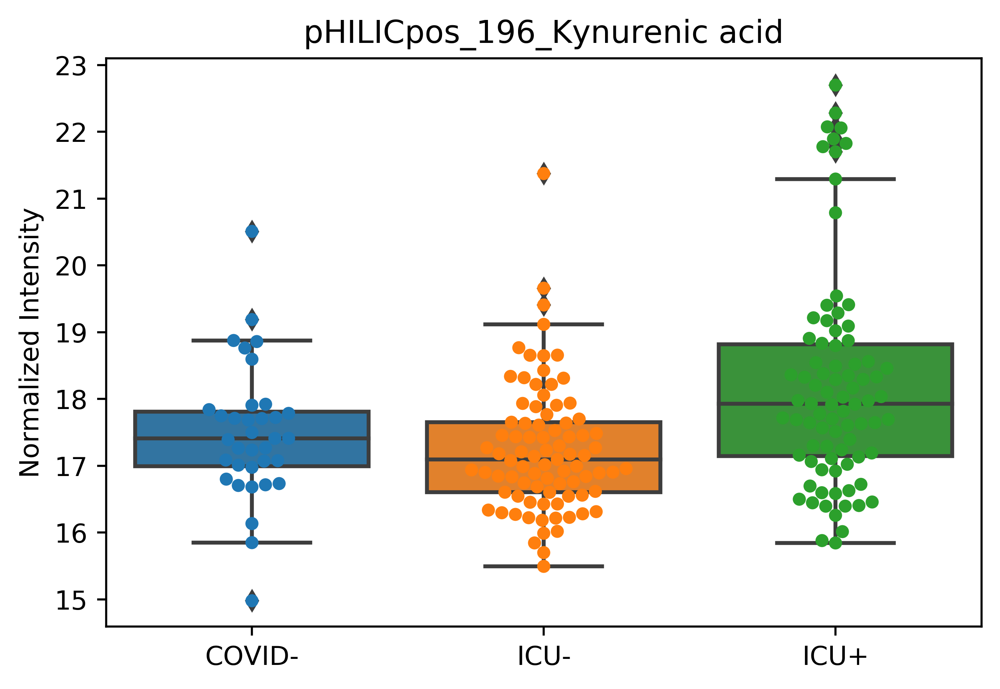

In [158]:
met = [x for x in range(len(mol_names)) if mol_names[x] == "pHILICpos_196_Kynurenic acid"][0] 
plt.figure()
norm = 1#np.median(X[:,met])
tempX = np.concatenate((X[:,met],X_val[:,met]))
tempy = np.concatenate((y,[-1 for x in X_val]))
tempDict = {}

for x,yy,i in zip(tempX,tempy,range(len(tempX))):
    tempDict[i] = {"ICU":yy,"Normalized Intensity":x}
tempDf = pd.DataFrame.from_dict(tempDict,orient="index")
sb.swarmplot(data=tempDf,x="ICU",y="Normalized Intensity")
sb.boxplot(data=tempDf,x="ICU",y="Normalized Intensity")
plt.title(mol_names[met])

plt.xticks([0,1,2],["COVID-","ICU-","ICU+"])
plt.xlabel("")

(2, 127)
[[20.67898871 18.21732641 22.05106551 15.71336151]
 [20.38151852 17.92133362 21.31462059 14.31249171]
 [20.58954568 18.54551374 22.82083574 14.6670091 ]
 [20.31106501 18.97021657 22.33759144 12.04193244]
 [20.54554567 18.50097651 21.98644203 14.3470655 ]
 [20.54919496 18.79222768 22.47153662 14.55100784]
 [20.34008599 17.23275089 20.19979293 14.5575156 ]
 [19.71455396 21.10419543 24.71072974 15.33130096]
 [20.48698195 18.22707957 22.3874462  13.2052716 ]
 [20.39418051 17.08970041 20.94333254 14.01707523]
 [20.31776868 17.47448369 22.1308317  14.79828166]
 [20.30520804 18.45272988 21.03643099 14.74853422]
 [20.33828927 18.43617088 22.35755769 13.31955006]
 [20.38492594 17.55606151 21.31690256 14.06268456]
 [20.24545154 16.91576098 22.00931262 14.03510934]
 [20.87506239 19.21820717 22.16172546 14.14368112]
 [19.85083019 21.28046561 25.88830042 15.1282658 ]
 [20.64637975 18.94613657 23.10241445 15.21074535]
 [20.61108037 18.68119342 23.28870288 13.70594216]
 [20.49344208 18.09511